In [ ]:
%%capture
!pip install opencv-python
!pip install scikit-learn-extra
!pip install scikit-learn-extra
!pip install --upgrade segments-ai
!import imghdr

import numpy as np
import imutils
import matplotlib.pyplot as plt
import PIL
import imghdr
import cv2
import os
import pandas as pd
from PIL import Image
from google.colab.patches import cv2_imshow
from segments import SegmentsClient
import shutil
import gc

from google.colab import drive
drive.mount('/content/drive')

##Single Image Manipulation Functions

In [ ]:
def resize_image(image, width, height):
    resized_image = cv2.resize(image, (width, height))
    return resized_image

def is_monochromatic(image, tolerance=30):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)
    h_std = np.std(h)
    s_std = np.std(s)
    v_std = np.std(v)
    if h_std > tolerance or s_std > tolerance or v_std > tolerance:
        return False
    else:
        return True

def is_blurry(image, threshold=50):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    variance = cv2.Laplacian(gray, cv2.CV_64F).var()
    return variance < threshold

##Multiple Images Manipulation Functions

In [ ]:
def read_images_and_names(dir_path, func=None):
    images_and_names = []
    for filename in os.listdir(dir_path):
        if filename.endswith(".png") or filename.endswith(".jpg") or filename.endswith(".PNG") or filename.endswith(".JPG"):
            file_path = os.path.join(dir_path, filename)
            image = cv2.imread(file_path)
            if func is not None:
              image = func(image)
            image_name = file_path.split("/")[-1].split(".")[0]
            images_and_names.append((image, image_name))
    return images_and_names


def cut_images(image, patch_height=300, patch_width=300):
    patches = []
    patches_with_cords = []
    width, height, _ = image.shape
    for i in range(0, height, patch_height):
        for j in range(0, width, patch_width):
            patch = image[j:j + patch_width, i:i + patch_height]
            patches.append(patch)
            patches_with_cords.append((patch, i, j))
    return np.array(patches), np.array(patches_with_cords)


def save_patches(image_name, patches, dir_path):
    subdir_path = os.path.join(dir_path, image_name)
    if not os.path.exists(subdir_path):
        os.makedirs(subdir_path)

    for i, patch in enumerate(patches):
        file_path = os.path.join(subdir_path, f"{image_name}_p{i}.jpg")
        cv2.imwrite(file_path, patch)


def apply_function_to_images(images_and_names, func):
    modified_images_and_names = []
    for image, name in images_and_names:
        modified_image = func(image)
        modified_images_and_names.append((modified_image, name))
    return modified_images_and_names


def preprocess_patches(dir_path, trichomes_images):
  """
  Preprocesses the patches of trichome images to remove monochromatic and blurry patches.

  Parameters:
  - dir_path (str): The path to the directory where the preprocessed patches will be saved.
  - trichomes_images (list): A list of tuples, where each tuple consists of a trichome image and the image name.

  Returns:
  - None
  """
  for i in range(len(trichomes_images)):
    # Unpack the image and image name from the tuple
    image, image_name = trichomes_images[i]
    # Cut the image into patches and get the patch coordinates
    patches, patchs_cords = cut_images(image)
    # Filter out monochromatic and blurry patches using a list comprehension
    patches = [patch for patch in patches if not is_monochromatic(patch) and not is_blurry(patch)]
    # Save the preprocessed patches to the specified directory
    save_patches(image_name, patches, dir_path)


### version 1 - Preprocess images to create patches

In [ ]:
thrichomes_path = 'trichomes counting project/trichomes images unprocessed/Camera2'
etay_path = f'/content/drive/MyDrive/{thrichomes_path}'

In [ ]:
trichomes_images = read_images_and_names(etay_path)
preprocess_patches("/content/trichomes_patches_Camera2", trichomes_images)

In [ ]:
!cp -r "/content/trichomes_patches_Camera2" "/content/drive/MyDrive/trichomes counting project/trichomes image patches"

###Clear Ram by removing trichomes_images

In [ ]:
del trichomes_images
gc.collect()

0

###Detect and Count Trichomes

In [ ]:
import cv2
import numpy as np

def detect_circles(path: str, total: int = None):
    """
    Detects circles in an image of trichomes, draws a red circle around each detected trichome, and displays the
    resulting image. Prints the total number of detected trichomes in the console.

    Args:
        path (str): The file path of the image to be processed.
        total (int, optional): The total number of trichomes in the image. If provided, this value will be
            included in the console output. Defaults to None.

    Returns:
        None

    """
    # Load the image
    img = cv2.imread(path)
    # Extract the image name from the file path
    name = path.split('/')[-1].split('.')[0]
    # Make a copy of the image
    img_copy = img.copy()
    # Convert the image to grayscale
    gray = cv2.cvtColor(img_copy, cv2.COLOR_BGR2GRAY)
    # Convert the grayscale image to black and white
    (thresh, im_bw) = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
    # Increase the threshold value to reduce noise
    thresh += 73
    black_white = cv2.threshold(gray, thresh, 255, cv2.THRESH_BINARY)[1]

    # Find contours in the black and white image
    cnts = cv2.findContours(black_white, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    cnts = cnts[0] if len(cnts) == 2 else cnts[1]

    count = 0
    # Loop over each contour
    for c in cnts:
        area = cv2.contourArea(c)
        _, _, w, h = cv2.boundingRect(c)
        ((x, y), r) = cv2.minEnclosingCircle(c)
        # If the contour has a small area, assume it is a trichome and draw a red circle around it
        if area < 20: # note - this param can be learnable
            cv2.circle(img_copy, (int(x), int(y)), int(r), (0, 0, 255), -1)
            count += 1
    str_total = ''
    # If the total number of trichomes is provided, include it in the console output
    if total is not None:
        str_total = f', We labeled {total}'
    # Print the number of detected trichomes to the console
    print(f'\t\t\t\tName: {name}, Total Trichomes: {count}{str_total}')
    # Display the original image, black and white image, and image with red circles around trichomes side by side
    black_white = np.repeat(black_white[:, :, np.newaxis], 3, axis=2)
    horizontal = np.concatenate((img, black_white, img_copy), axis=1)
    cv2_imshow(horizontal)


def experiment_directory(directory):
    for filename in os.listdir(directory):
        f = os.path.join(directory, filename)
        detect_cirlces(f)

				Name: IMG_5757_p0, Total Trichomes: 143


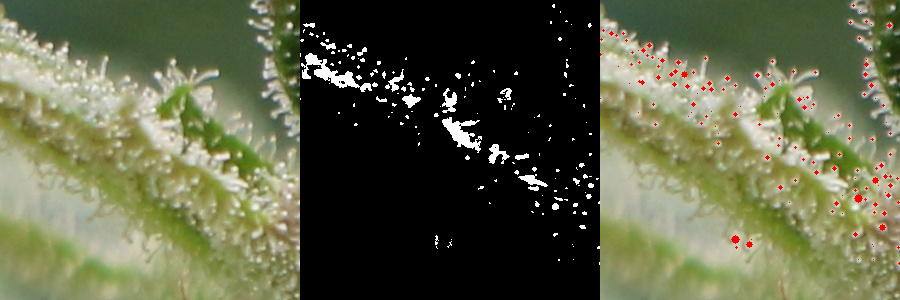

				Name: IMG_5757_p1, Total Trichomes: 94


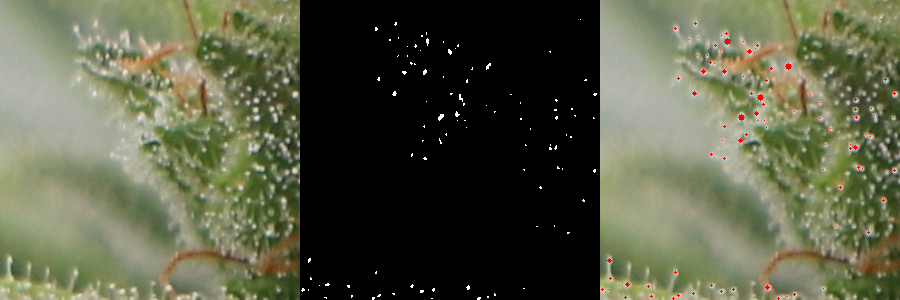

				Name: IMG_5757_p2, Total Trichomes: 26


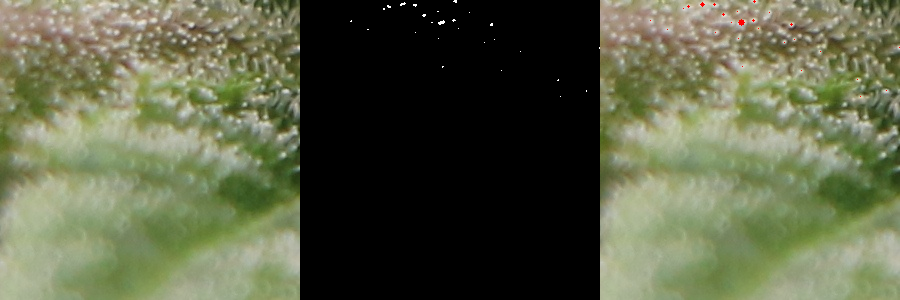

				Name: IMG_5757_p3, Total Trichomes: 88


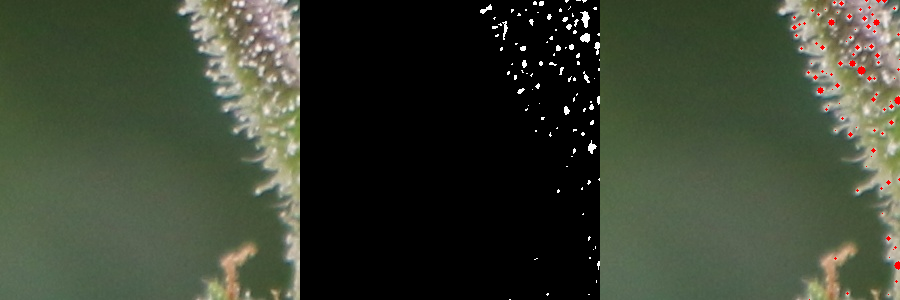

				Name: IMG_5757_p4, Total Trichomes: 165


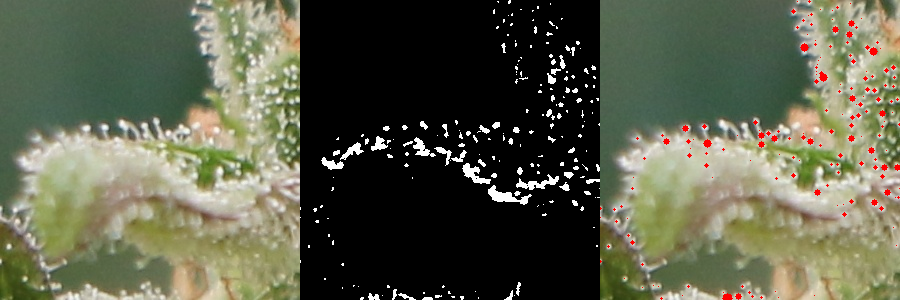

				Name: IMG_5757_p5, Total Trichomes: 224


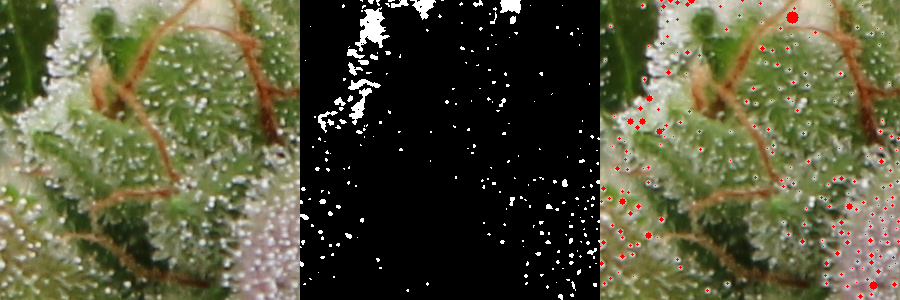

				Name: IMG_5757_p6, Total Trichomes: 93


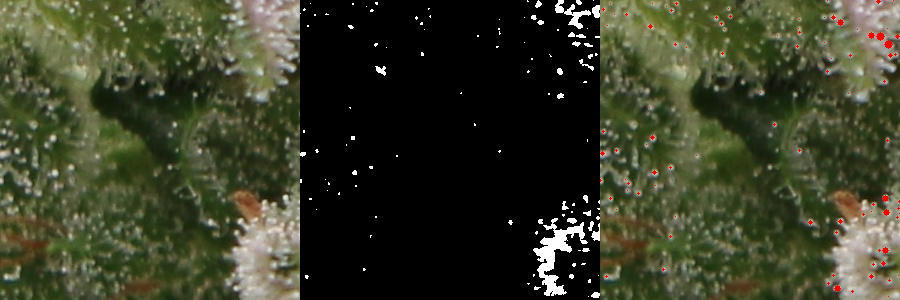

				Name: IMG_5757_p7, Total Trichomes: 123


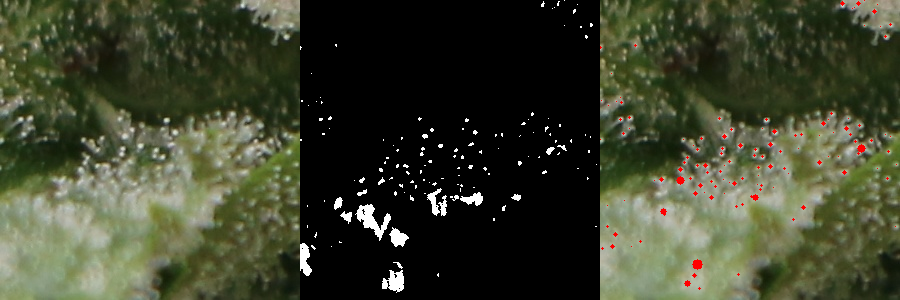

				Name: IMG_5757_p8, Total Trichomes: 91


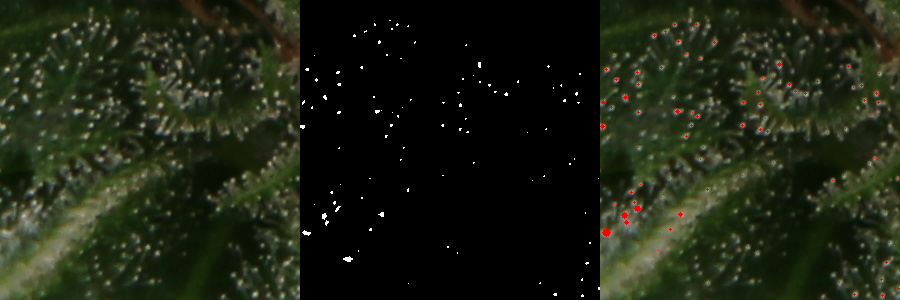

				Name: IMG_5757_p9, Total Trichomes: 260


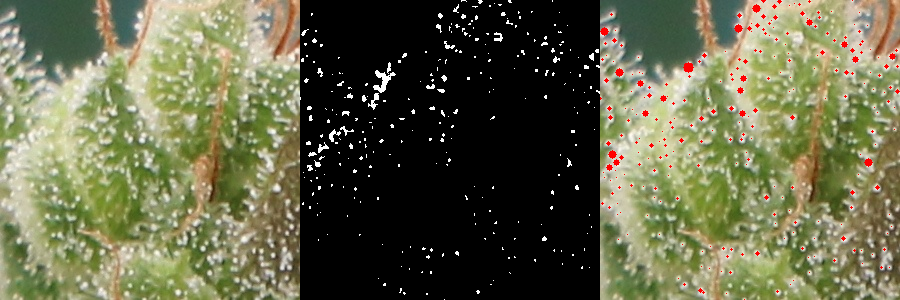

				Name: IMG_5757_p10, Total Trichomes: 239


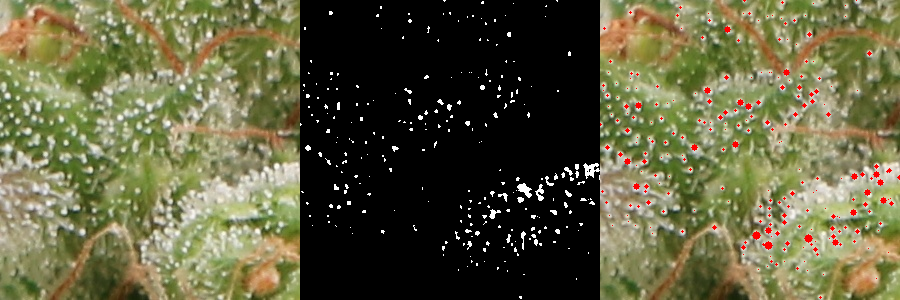

				Name: IMG_5757_p11, Total Trichomes: 235


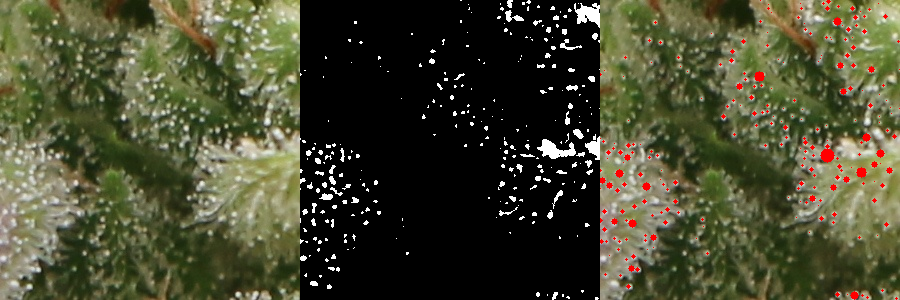

				Name: IMG_5757_p12, Total Trichomes: 258


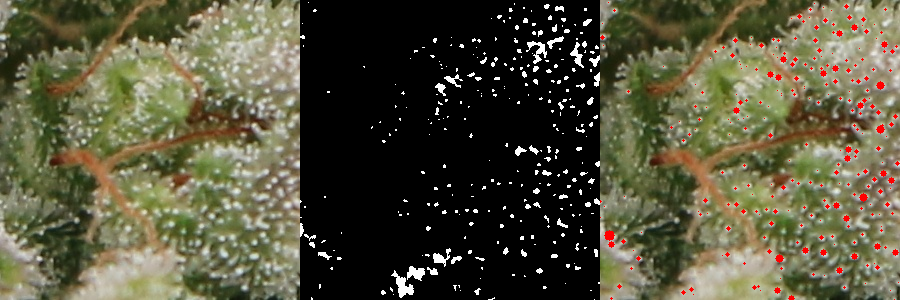

				Name: IMG_5757_p13, Total Trichomes: 150


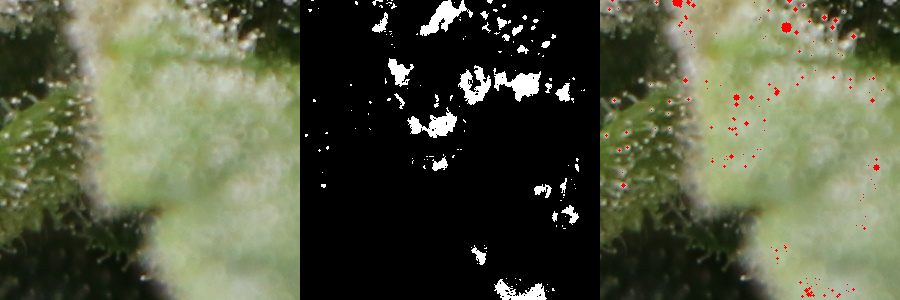

				Name: IMG_5757_p14, Total Trichomes: 45


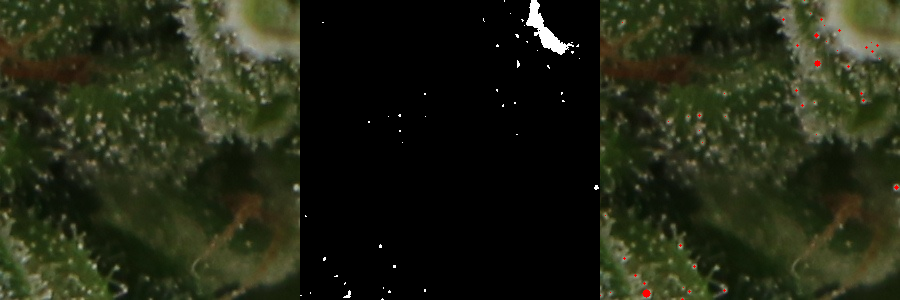

				Name: IMG_5757_p15, Total Trichomes: 83


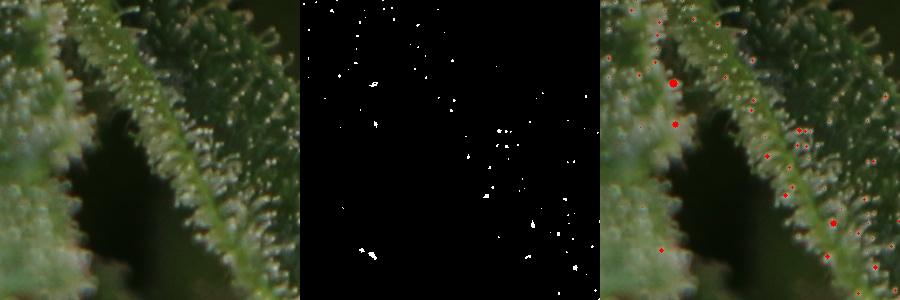

				Name: IMG_5757_p16, Total Trichomes: 154


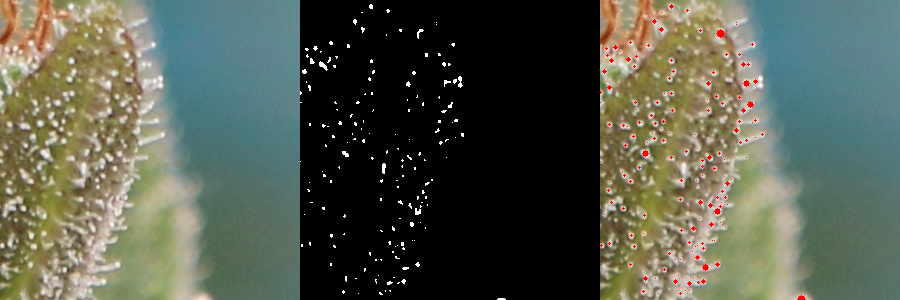

				Name: IMG_5757_p17, Total Trichomes: 67


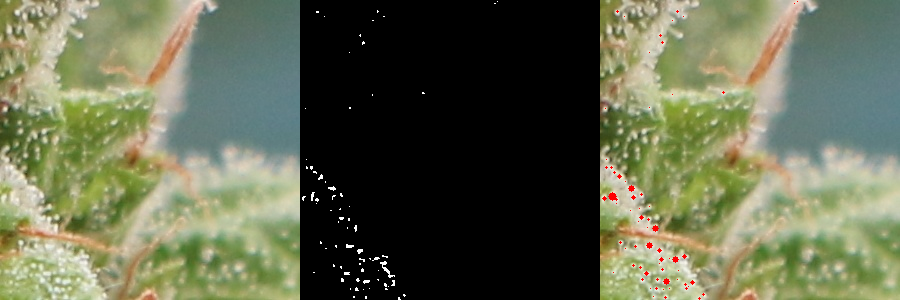

				Name: IMG_5757_p18, Total Trichomes: 55


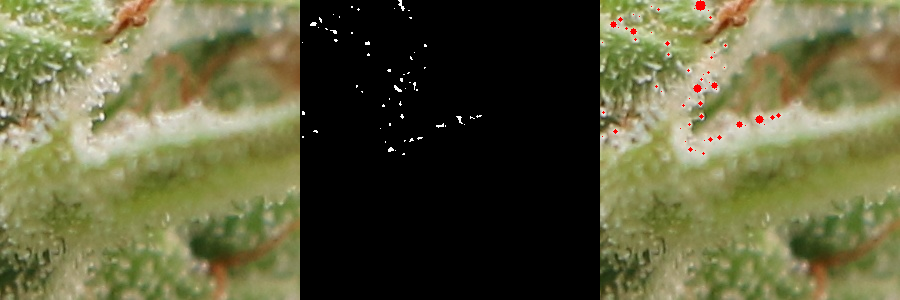

				Name: IMG_5757_p19, Total Trichomes: 230


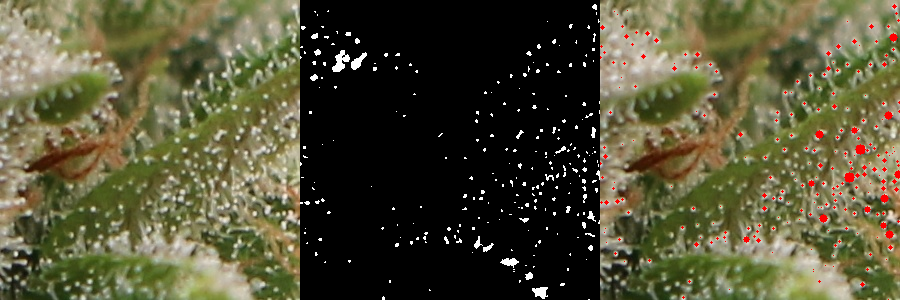

				Name: IMG_5757_p20, Total Trichomes: 124


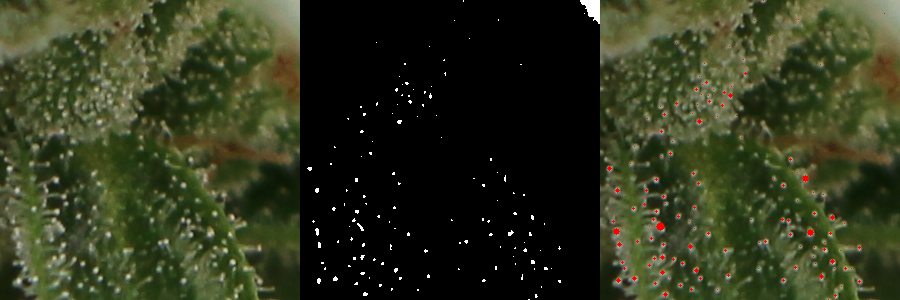

				Name: IMG_5757_p21, Total Trichomes: 137


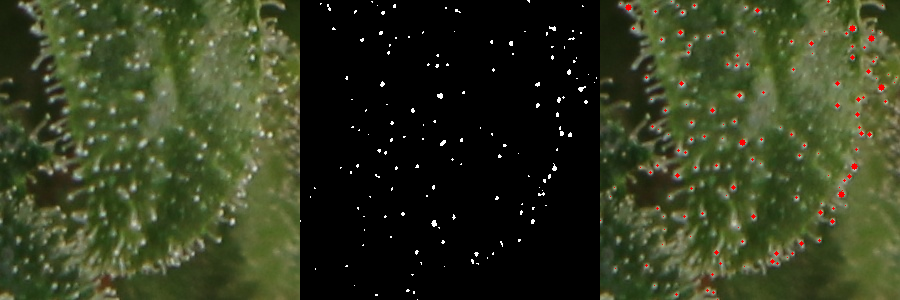

				Name: IMG_5757_p22, Total Trichomes: 38


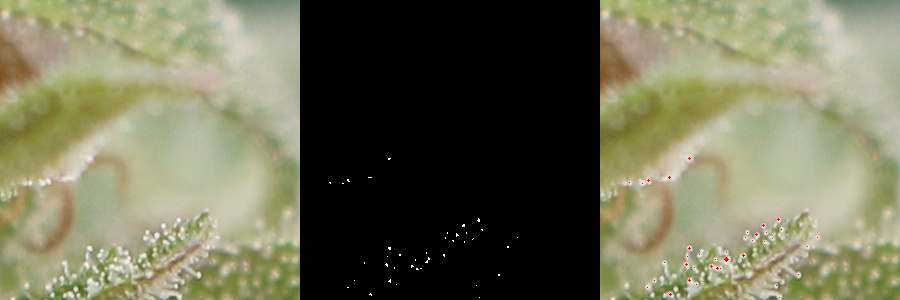

				Name: IMG_5757_p23, Total Trichomes: 178


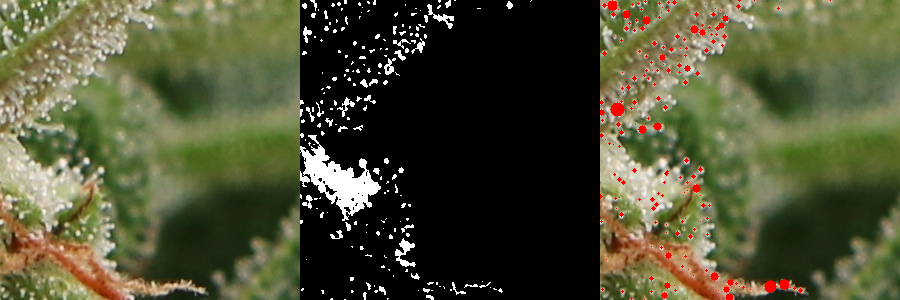

				Name: IMG_5757_p24, Total Trichomes: 197


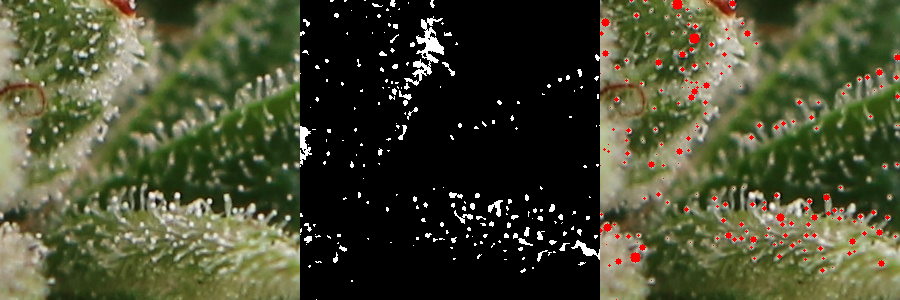

				Name: IMG_5757_p25, Total Trichomes: 33


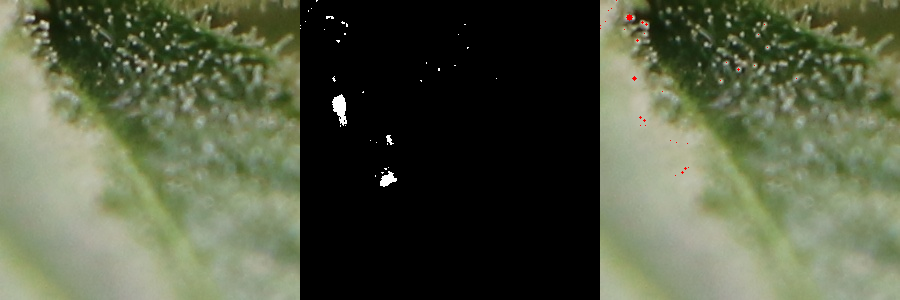

				Name: IMG_5757_p26, Total Trichomes: 73


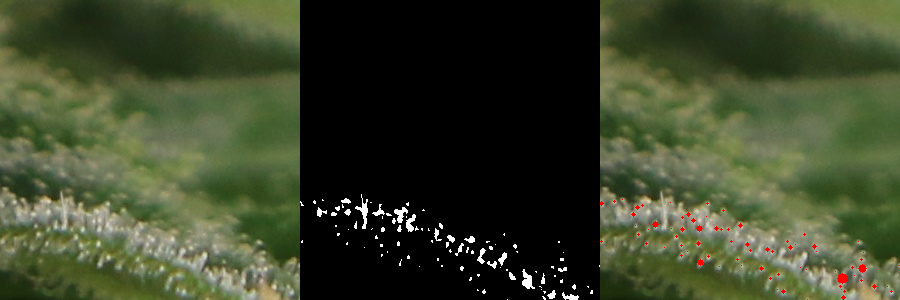

				Name: IMG_5757_p27, Total Trichomes: 177


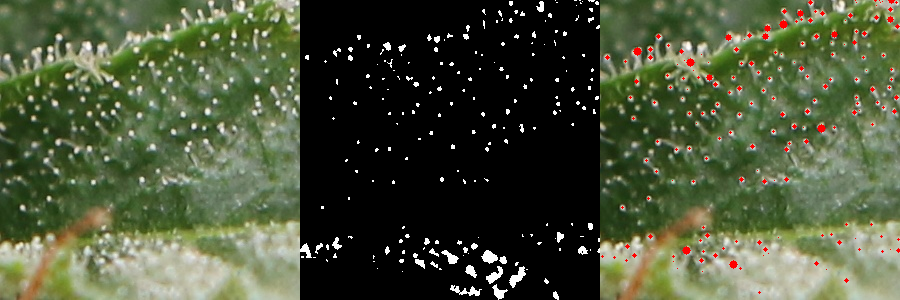

				Name: IMG_5757_p28, Total Trichomes: 17


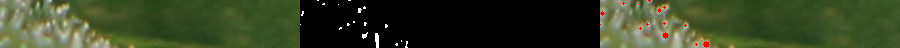

				Name: IMG_5757_p29, Total Trichomes: 81


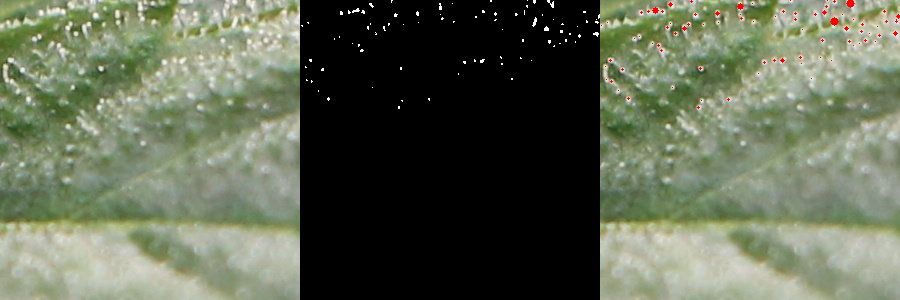

In [ ]:
experiment_directory('/content/drive/MyDrive/trichomes counting project/trichomes image patches/trichomes_patches_Camera/IMG_5757')

				Name: IMG_5758_p26, Total Trichomes: 41


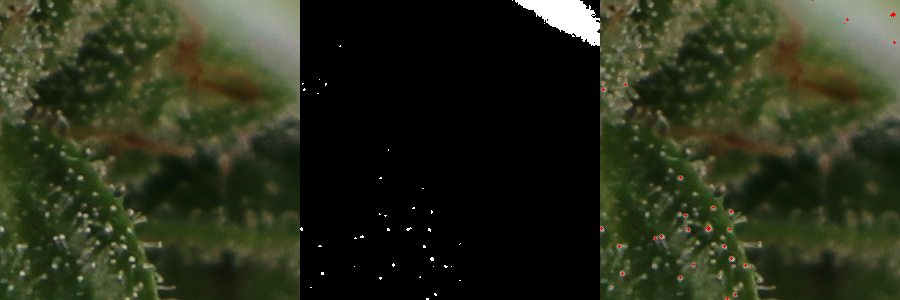

				Name: IMG_5758_p12, Total Trichomes: 126


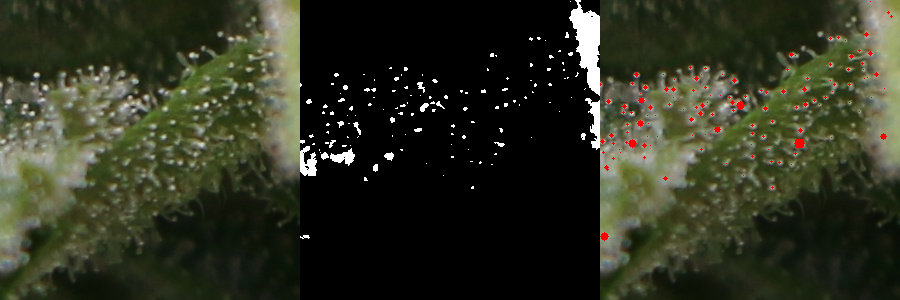

				Name: IMG_5758_p5, Total Trichomes: 126


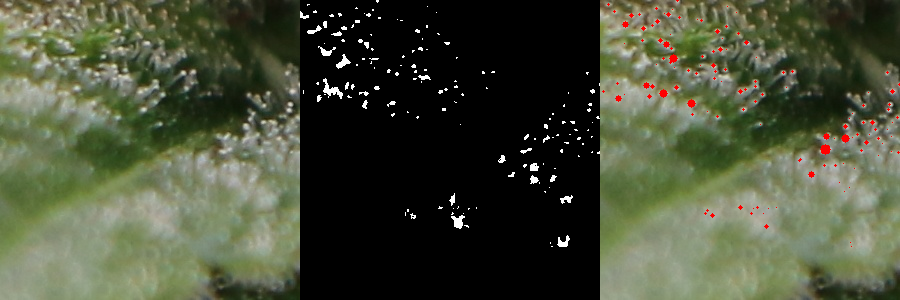

				Name: IMG_5758_p18, Total Trichomes: 325


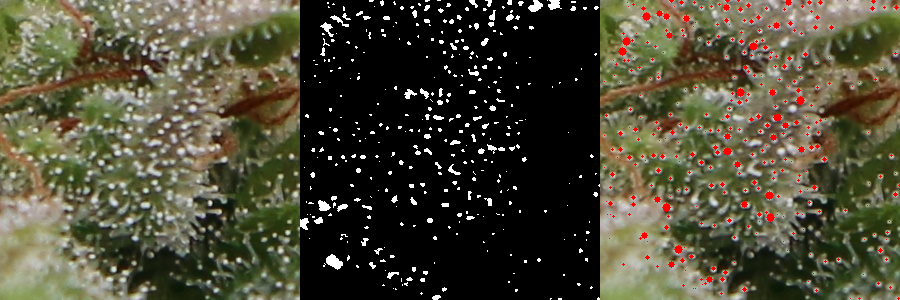

				Name: IMG_5758_p32, Total Trichomes: 36


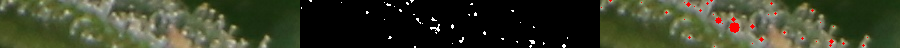

				Name: IMG_5758_p15, Total Trichomes: 218


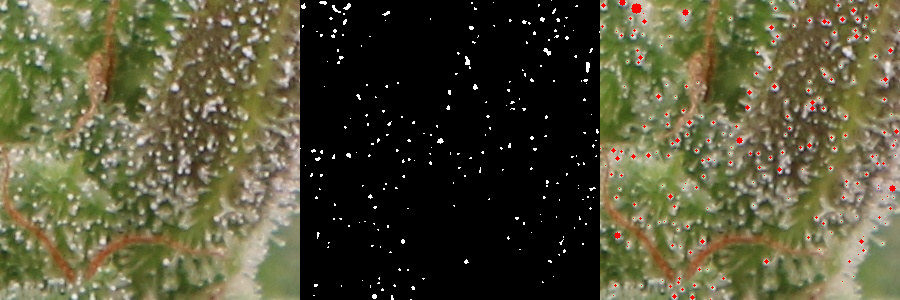

				Name: IMG_5758_p25, Total Trichomes: 35


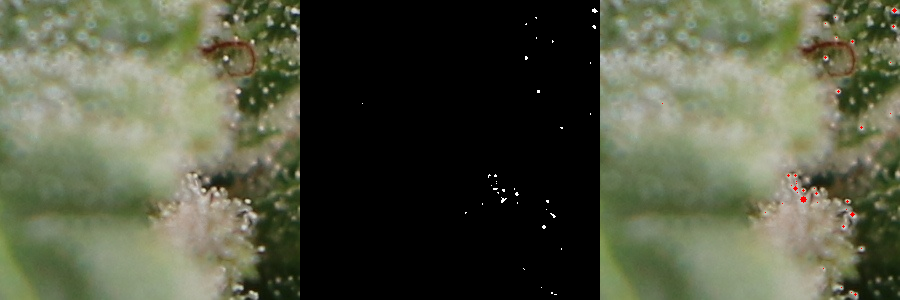

				Name: IMG_5758_p21, Total Trichomes: 115


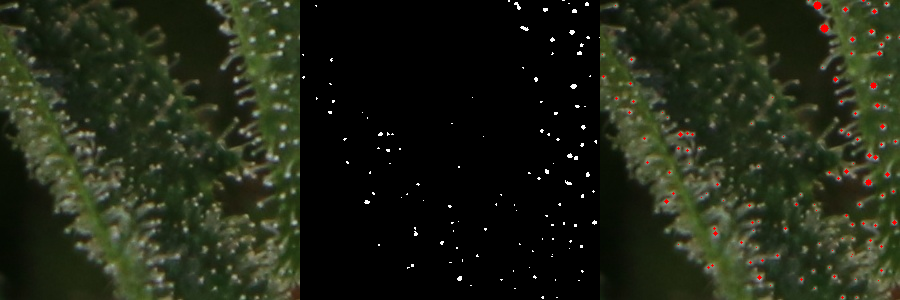

				Name: IMG_5758_p11, Total Trichomes: 108


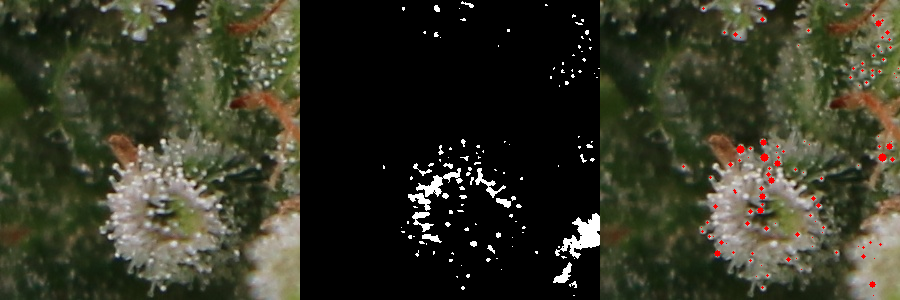

				Name: IMG_5758_p4, Total Trichomes: 113


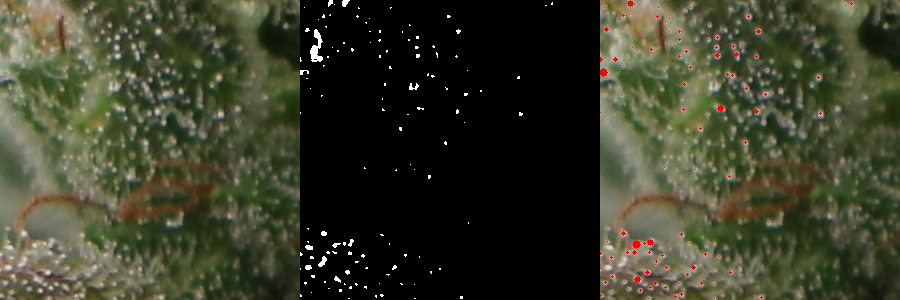

				Name: IMG_5758_p14, Total Trichomes: 165


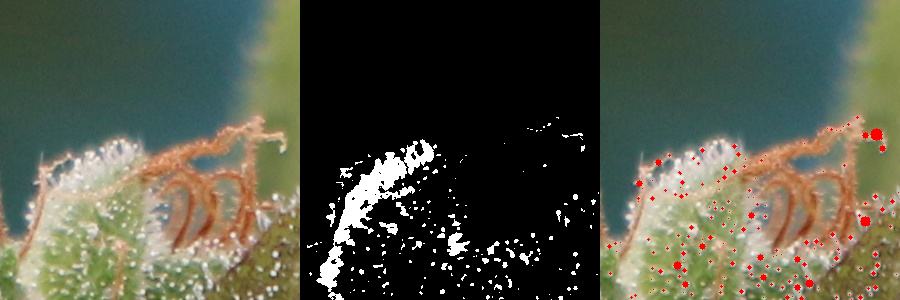

				Name: IMG_5758_p8, Total Trichomes: 169


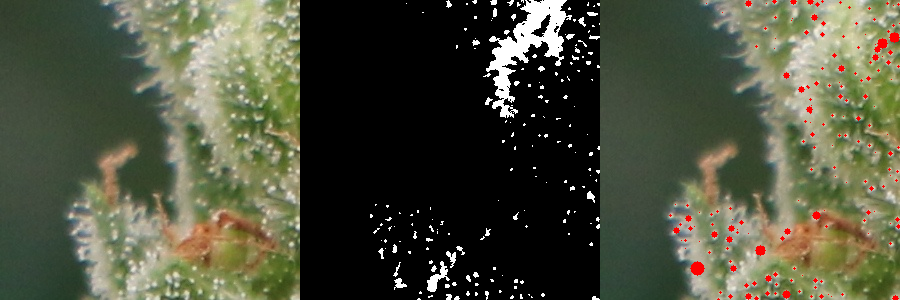

				Name: IMG_5758_p34, Total Trichomes: 114


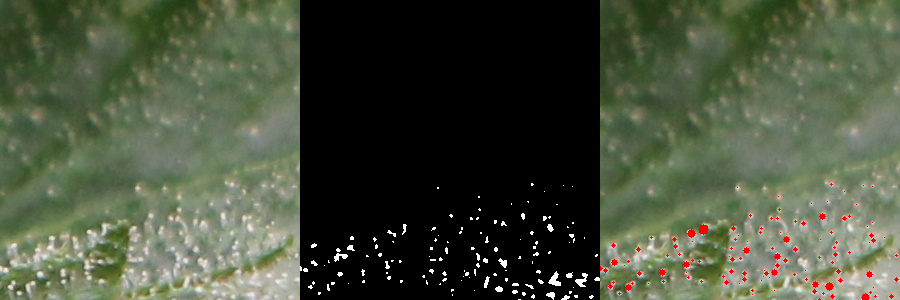

				Name: IMG_5758_p23, Total Trichomes: 68


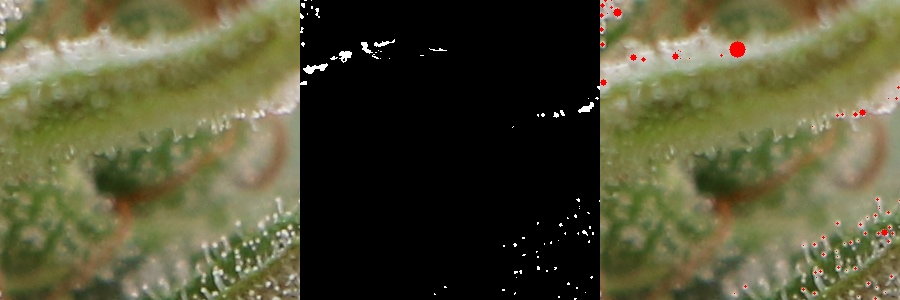

				Name: IMG_5758_p1, Total Trichomes: 56


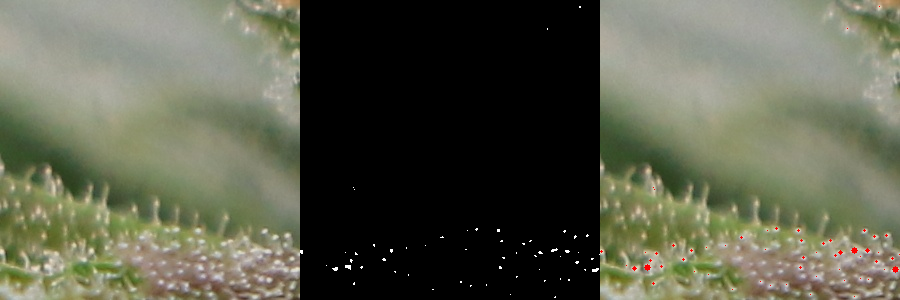

				Name: IMG_5758_p19, Total Trichomes: 47


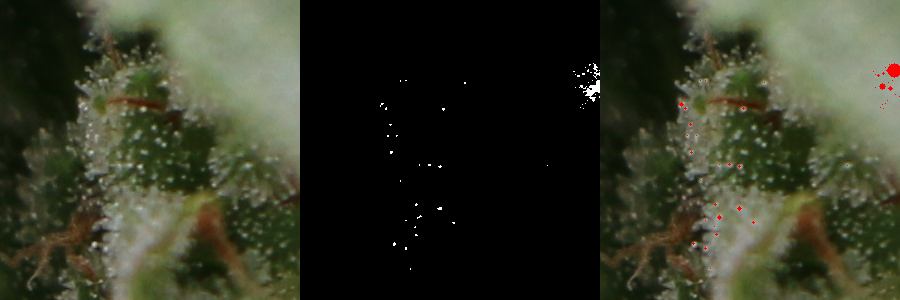

				Name: IMG_5758_p27, Total Trichomes: 96


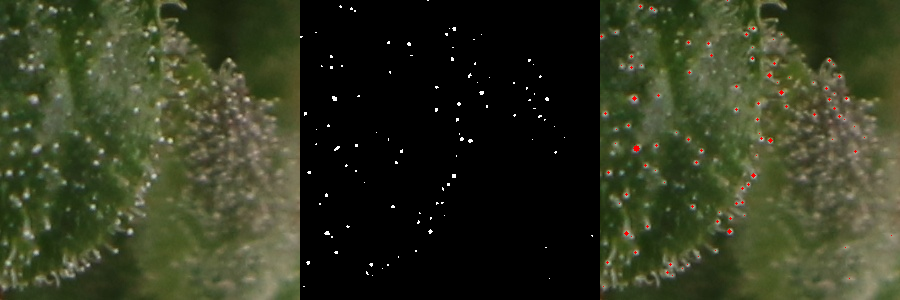

				Name: IMG_5758_p9, Total Trichomes: 176


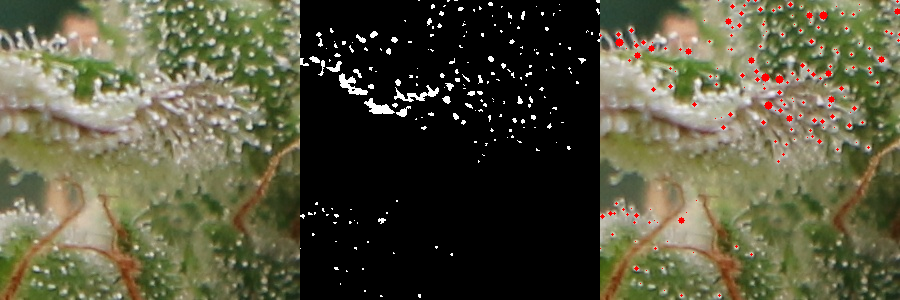

				Name: IMG_5758_p30, Total Trichomes: 153


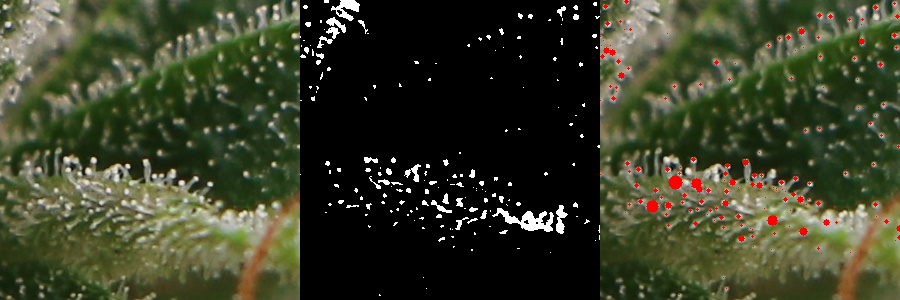

				Name: IMG_5758_p17, Total Trichomes: 197


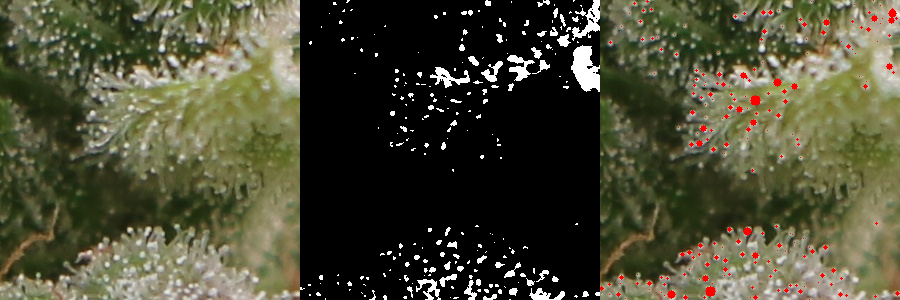

				Name: IMG_5758_p10, Total Trichomes: 237


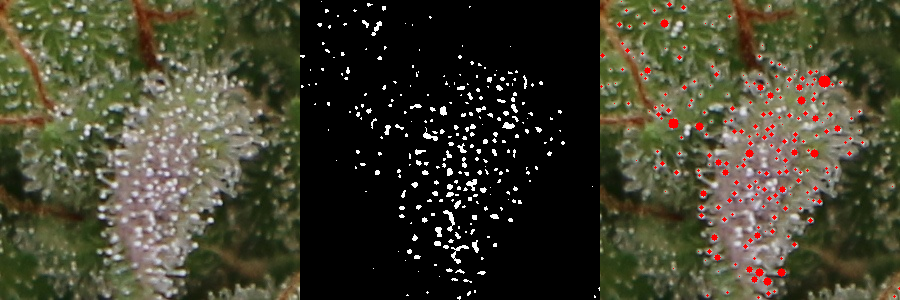

				Name: IMG_5758_p31, Total Trichomes: 16


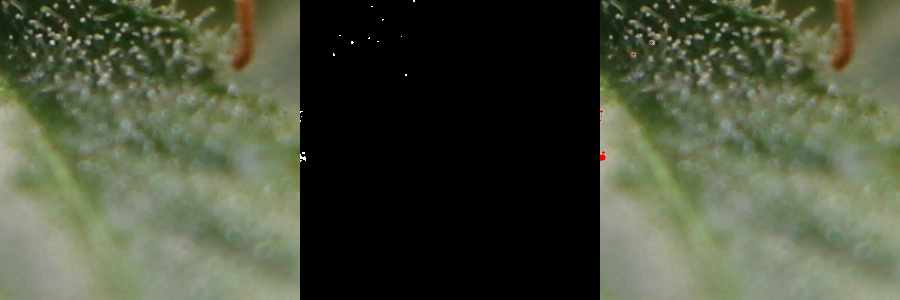

				Name: IMG_5758_p33, Total Trichomes: 152


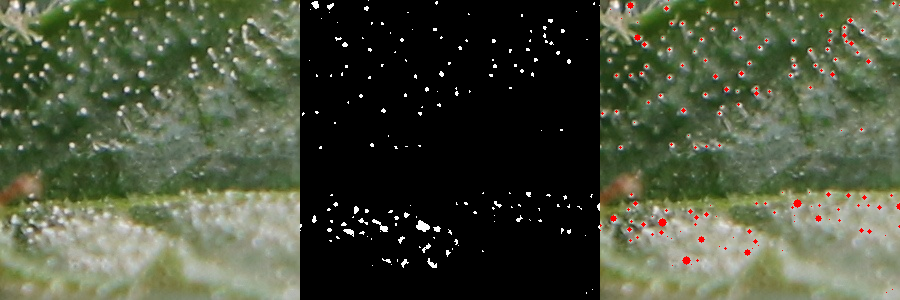

				Name: IMG_5758_p0, Total Trichomes: 84


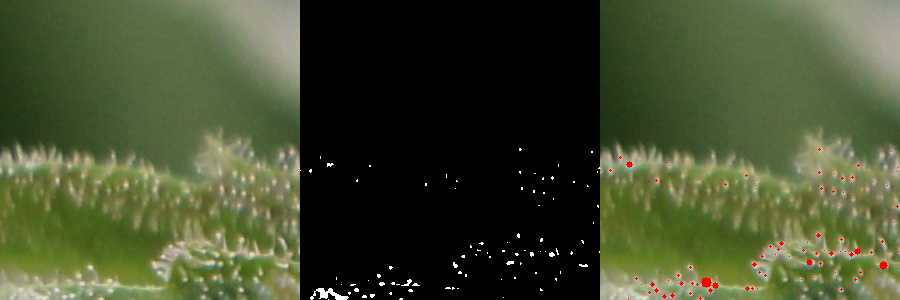

				Name: IMG_5758_p3, Total Trichomes: 133


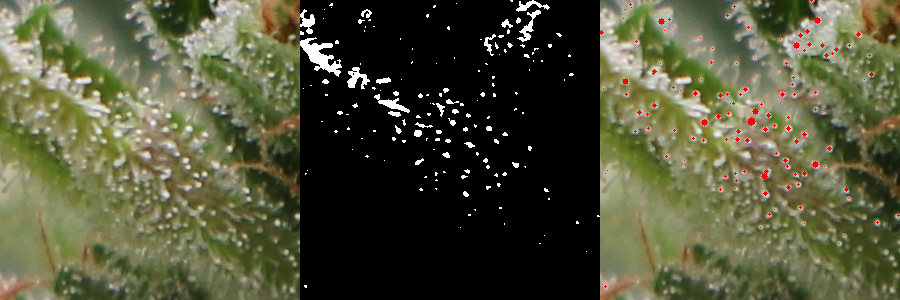

				Name: IMG_5758_p16, Total Trichomes: 256


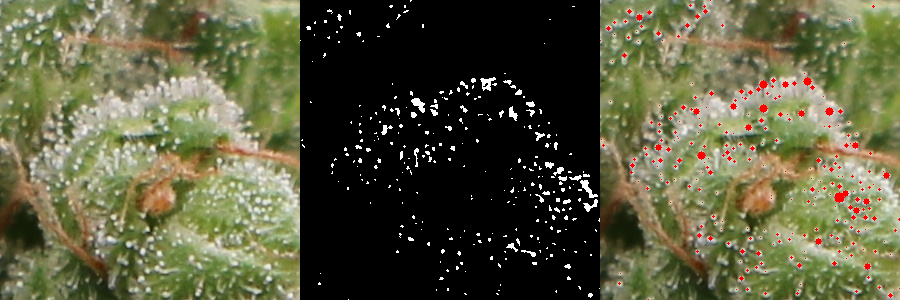

				Name: IMG_5758_p28, Total Trichomes: 57


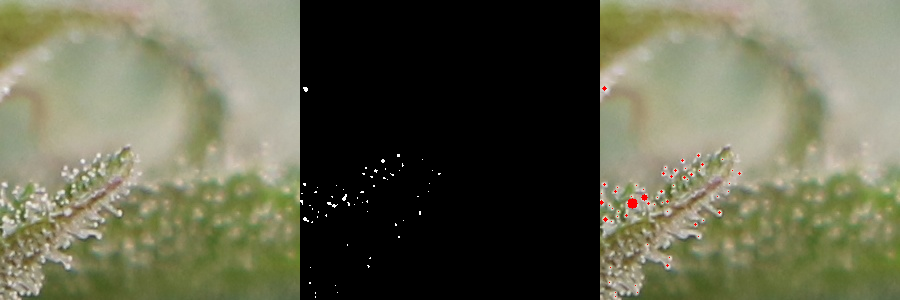

				Name: IMG_5758_p22, Total Trichomes: 102


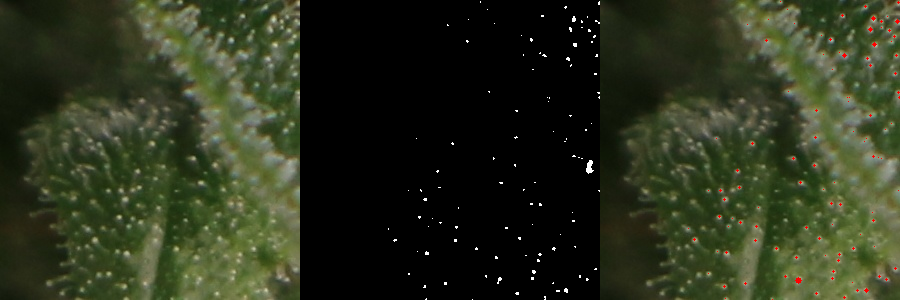

				Name: IMG_5758_p24, Total Trichomes: 241


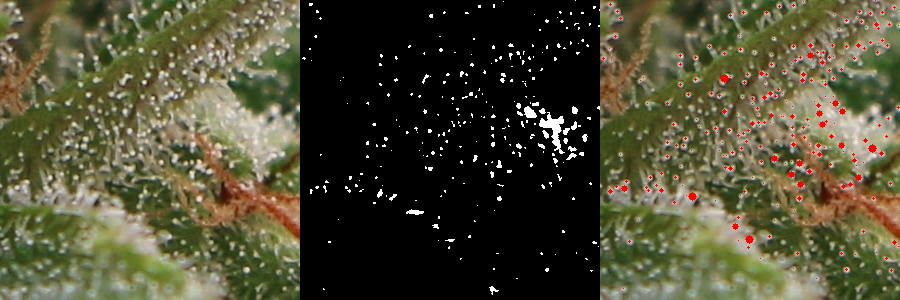

				Name: IMG_5758_p29, Total Trichomes: 44


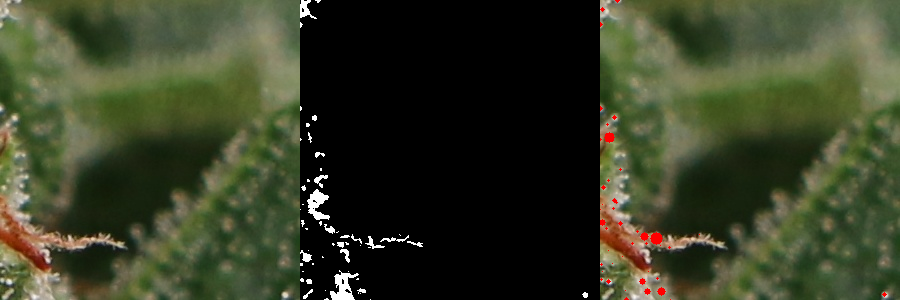

				Name: IMG_5758_p2, Total Trichomes: 83


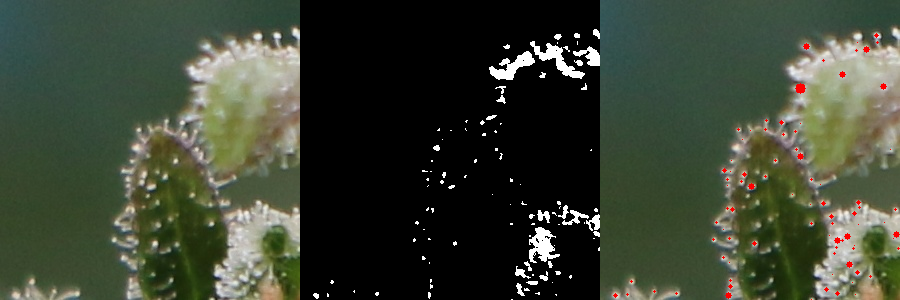

				Name: IMG_5758_p20, Total Trichomes: 79


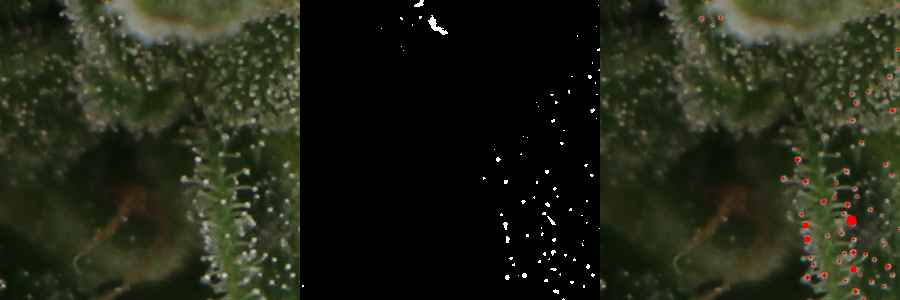

				Name: IMG_5758_p13, Total Trichomes: 88


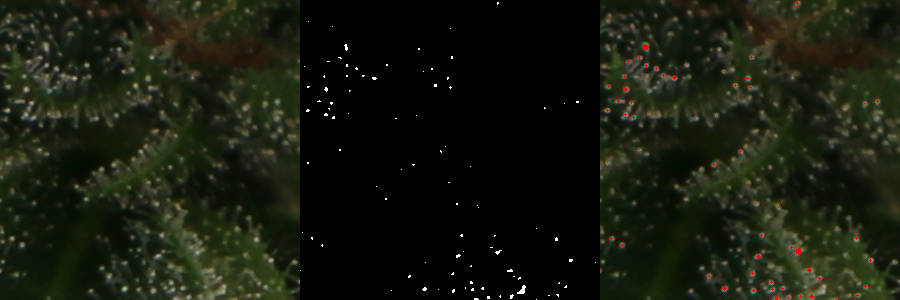

				Name: IMG_5758_p7, Total Trichomes: 102


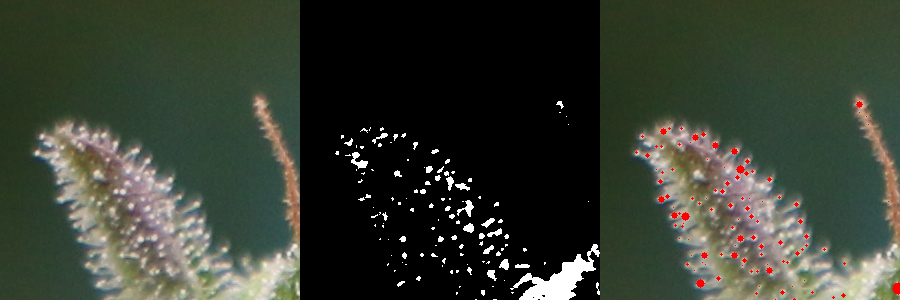

				Name: IMG_5758_p6, Total Trichomes: 86


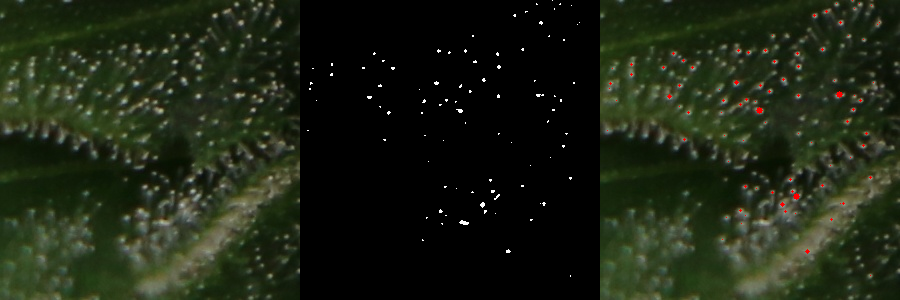

In [ ]:
experiment_directory('/content/trichomes_patches/IMG_5758')

In [ ]:
ground_truth = {'/content/drive/MyDrive/trichomes counting project/trichomes image patches/trichomes_patches_Camera/IMG_5757/IMG_5757_p27.jpg': 163,
                '/content/drive/MyDrive/trichomes counting project/trichomes image patches/trichomes_patches_Camera/IMG_5883/IMG_5883_p10.jpg': 113, #p35
                '/content/drive/MyDrive/trichomes counting project/trichomes image patches/trichomes_patches_Camera/IMG_5883/IMG_5883_p16.jpg': 103, #p45
                '/content/drive/MyDrive/trichomes counting project/trichomes image patches/trichomes_patches_Camera/IMG_5883/IMG_5883_p9.jpg': 140,
                '/content/drive/MyDrive/trichomes counting project/trichomes image patches/trichomes_patches_Camera/IMG_5884/IMG_5884_p24.jpg': 75,
                '/content/drive/MyDrive/trichomes counting project/trichomes image patches/trichomes_patches_Camera/IMG_5884/IMG_5884_p12.jpg': 45, #p37
                '/content/drive/MyDrive/trichomes counting project/trichomes image patches/trichomes_patches_Camera/IMG_5884/IMG_5884_p9.jpg': 86,
                '/content/drive/MyDrive/trichomes counting project/trichomes image patches/trichomes_patches_Camera/IMG_5885/IMG_5885_p2.jpg': 72,
                '/content/drive/MyDrive/trichomes counting project/trichomes image patches/trichomes_patches_Camera/IMG_5885/IMG_5885_p20.jpg': 81,
                '/content/drive/MyDrive/trichomes counting project/trichomes image patches/trichomes_patches_Camera/IMG_5885/IMG_5885_p3.jpg': 85,
                '/content/drive/MyDrive/trichomes counting project/trichomes image patches/trichomes_patches_Camera/IMG_5885/IMG_5885_p20.jpg': 82} #p37

				Name: IMG_5757_p27, Total Trichomes: 177, We labeled 163


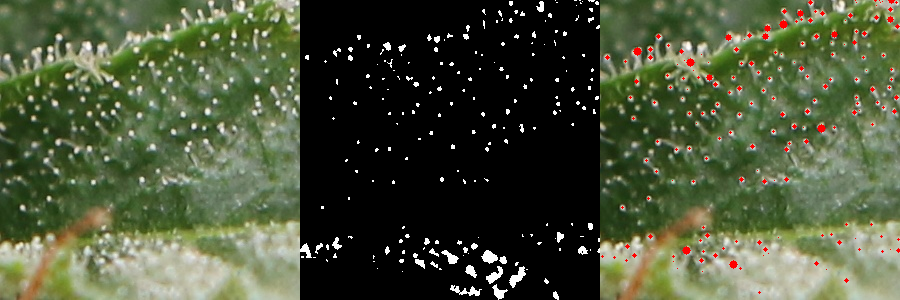

				Name: IMG_5883_p10, Total Trichomes: 125, We labeled 113


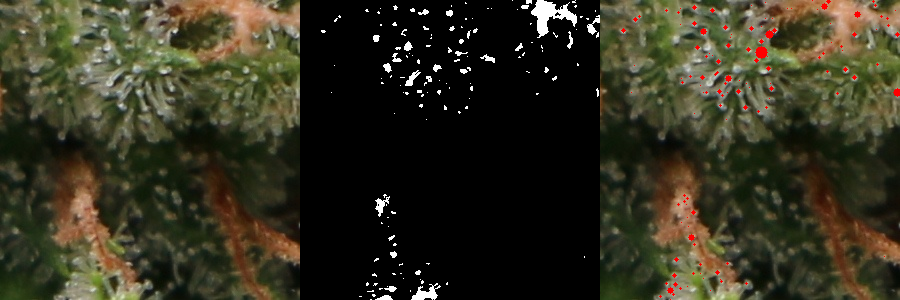

				Name: IMG_5883_p16, Total Trichomes: 130, We labeled 103


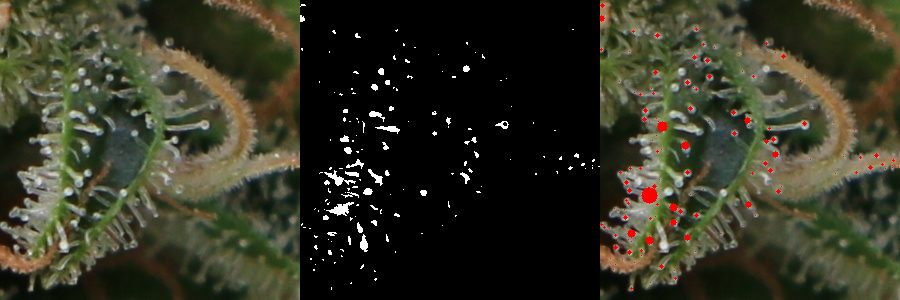

				Name: IMG_5883_p9, Total Trichomes: 200, We labeled 140


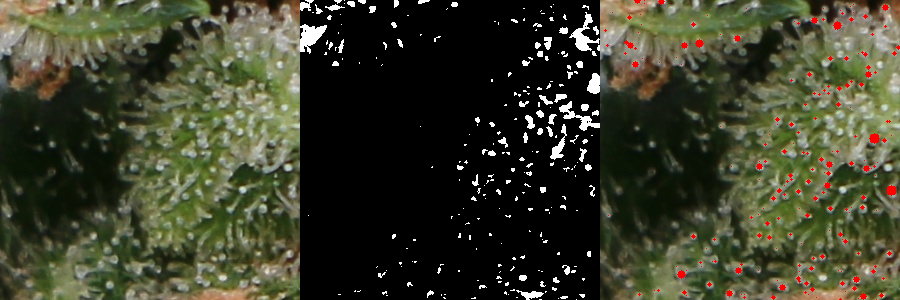

				Name: IMG_5884_p24, Total Trichomes: 78, We labeled 75


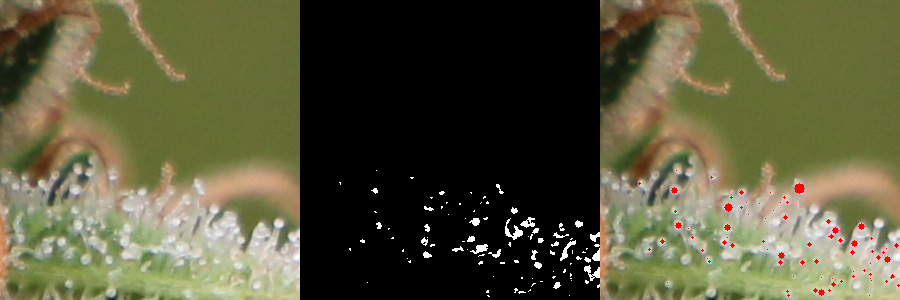

				Name: IMG_5884_p12, Total Trichomes: 3, We labeled 45


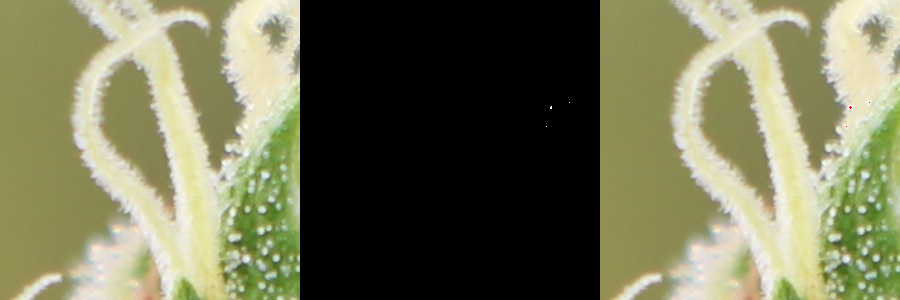

				Name: IMG_5884_p9, Total Trichomes: 188, We labeled 86


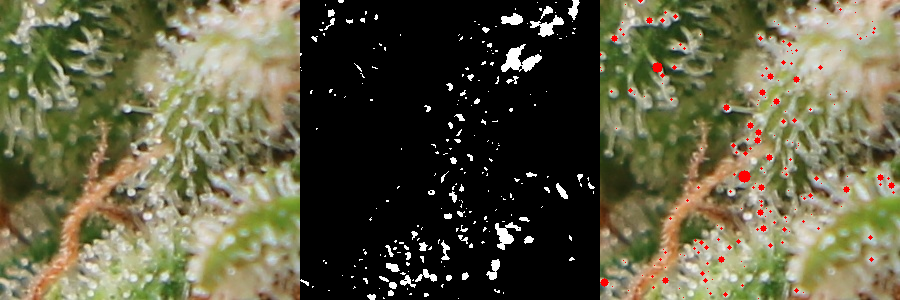

				Name: IMG_5885_p2, Total Trichomes: 45, We labeled 72


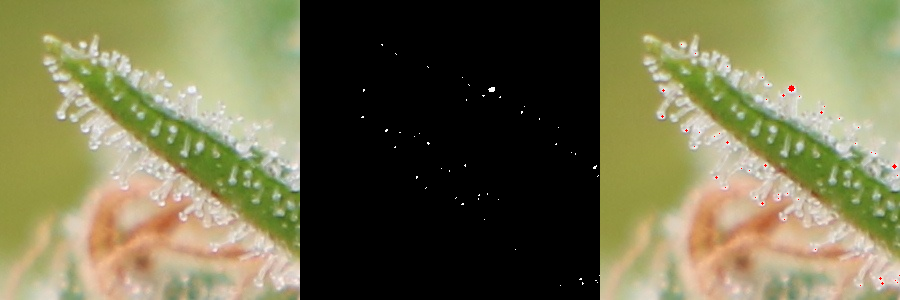

				Name: IMG_5885_p20, Total Trichomes: 187, We labeled 82


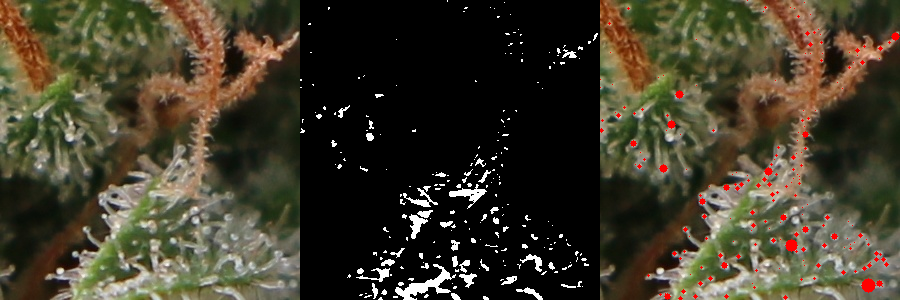

				Name: IMG_5885_p3, Total Trichomes: 131, We labeled 85


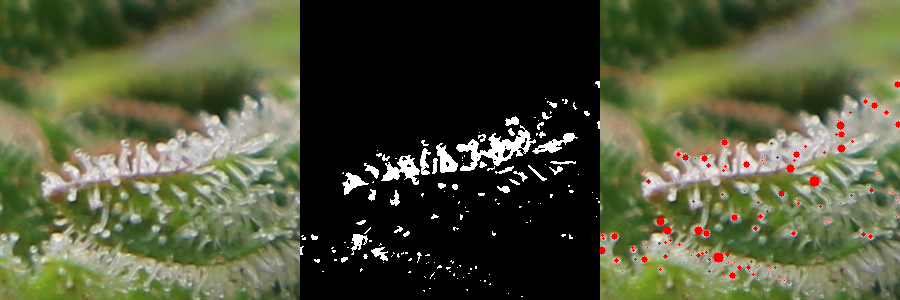

In [ ]:
for filename, total in ground_truth.items():
    detect_cirlces(filename, total)

In [ ]:
def rotate_image(image, angle):
    rows, cols = image.shape[:2]
    M = cv2.getRotationMatrix2D((cols/2,rows/2), angle, 1)
    rotated = cv2.warpAffine(image, M, (cols, rows))
    return rotated

def rescale_image(image, scaling):
    width, height = int(image.shape[0]*scaling), int(image.shape[1]*scaling)
    resized_image = cv2.resize(image, (width, height))
    return resized_image

def flip_image(image, direction):
    if direction == "horizontal":
        flip_code = 0
    elif direction == "vertical":
        flip_code = 1
    elif direction == "both":
        flip_code = -1
    flipped_img = cv2.flip(image, flip_code)
    return flipped_img

def rgb_to_hsv(image):
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    return hsv_image

def rgb_to_lab(image):
    lab_image = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    return lab_image

def dilation(image):
    kernel_size = 2
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (kernel_size, kernel_size))
    dilated_image = cv2.dilate(image, kernel)
    return dilated_image

In [ ]:
def detect_cirlces(path, rotate=None, rescale=None, flip=None, dilation=False, our_label=None):
    img = cv2.imread(path)
    name = path.split('/')[-1].split('.')[0]

    if rotate:
        img = rotate_image(img, rotate)
    if rescale:
        img = rescale_image(img, rescale)
    if flip:
        img = flip_image(img, flip)

    img_copy = img.copy()
    gray = cv2.cvtColor(img_copy, cv2.COLOR_BGR2GRAY)
    (thresh, im_bw) = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
    thresh+=70
    black_white = cv2.threshold(gray, thresh, 255, cv2.THRESH_BINARY)[1]

    cnts = cv2.findContours(black_white, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    cnts = cnts[0] if len(cnts) == 2 else cnts[1]

    count = 0
    for c in cnts:
        area = cv2.contourArea(c)
        _,_,w,h = cv2.boundingRect(c)
        ((x, y), r) = cv2.minEnclosingCircle(c)
        if area < np.log(img.shape[0] * img.shape[1])*3.6:
            cv2.circle(img_copy, (int(x), int(y)), int(r), (0, 0, 255), -1)
            count += 1

    str_total = ''
    if total is not None:
        str_total = f', We labeled {total}'
    print(f'\t\t\t\tName: {name}, Total Trichomes: {count}{str_total}')
    black_white = np.repeat(black_white[:, :, np.newaxis], 3, axis=2)
    horizontal = np.concatenate((img, black_white, img_copy), axis=1)
    cv2_imshow(horizontal)

def experiment_directory(directory):
    for filename in os.listdir(directory):
        f = os.path.join(directory, filename)
        detect_cirlces(f)

### No Transformation

				Name: IMG_5757_p27, Total Trichomes: 191, We labeled 163


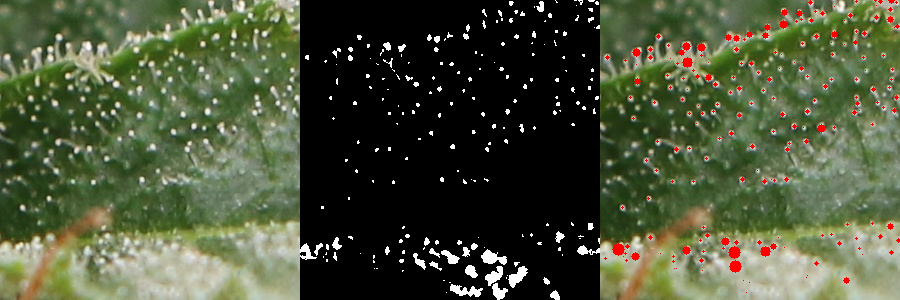

				Name: IMG_5883_p10, Total Trichomes: 142, We labeled 113


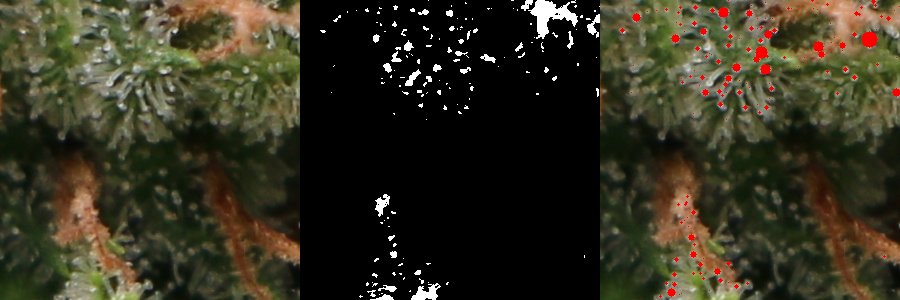

				Name: IMG_5883_p16, Total Trichomes: 164, We labeled 103


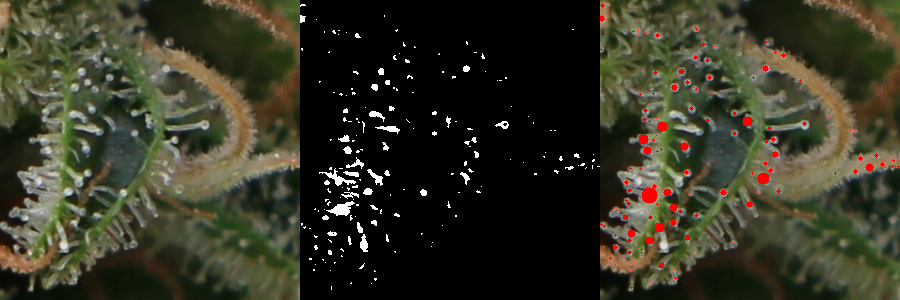

				Name: IMG_5883_p9, Total Trichomes: 218, We labeled 140


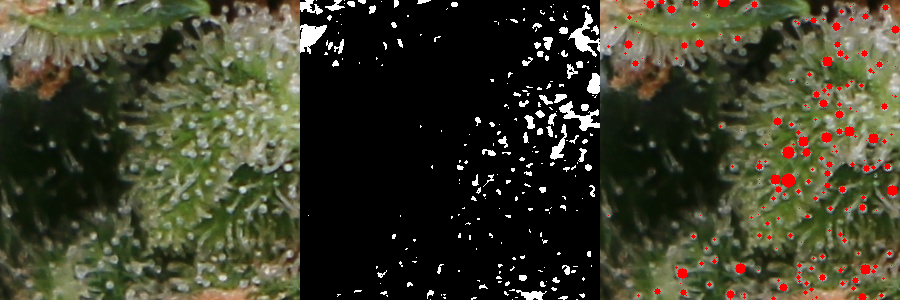

				Name: IMG_5884_p24, Total Trichomes: 81, We labeled 75


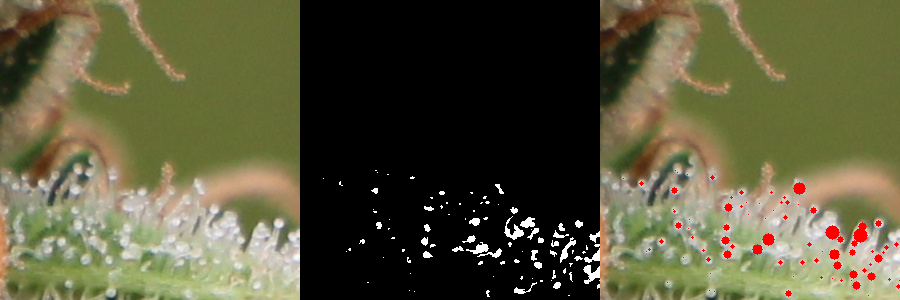

				Name: IMG_5884_p12, Total Trichomes: 6, We labeled 45


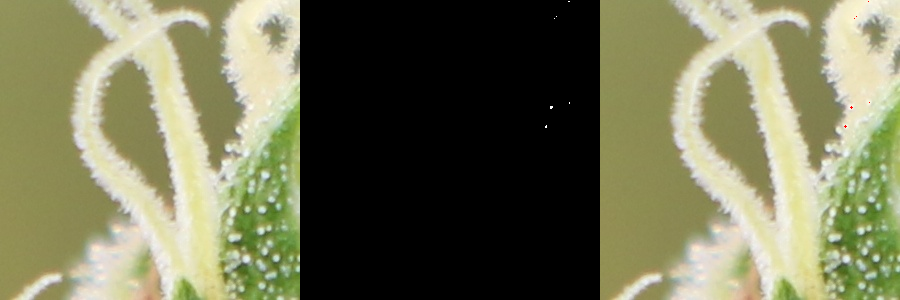

				Name: IMG_5884_p9, Total Trichomes: 213, We labeled 86


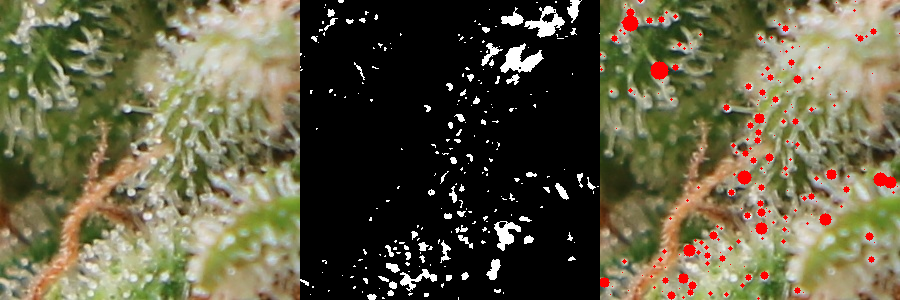

				Name: IMG_5885_p2, Total Trichomes: 55, We labeled 72


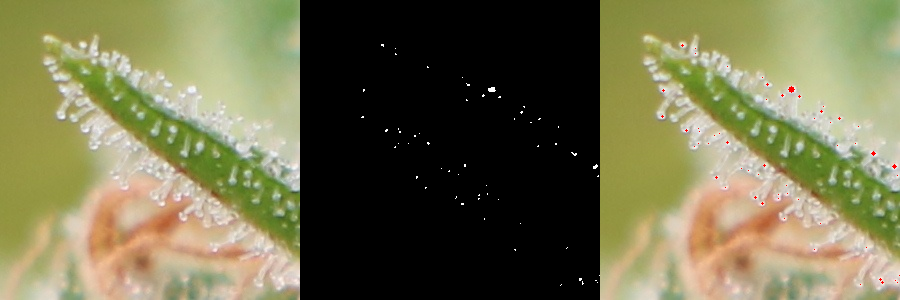

				Name: IMG_5885_p20, Total Trichomes: 198, We labeled 82


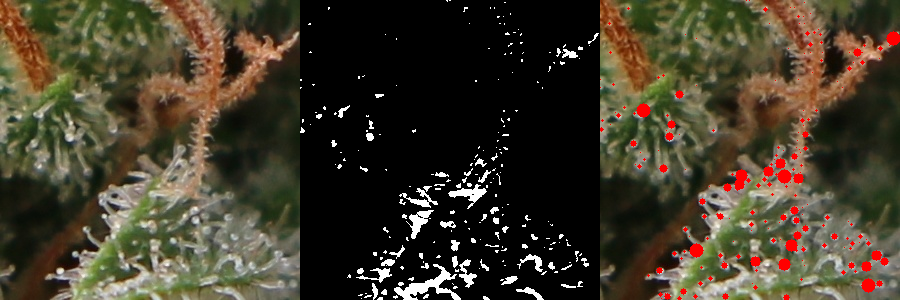

				Name: IMG_5885_p3, Total Trichomes: 146, We labeled 85


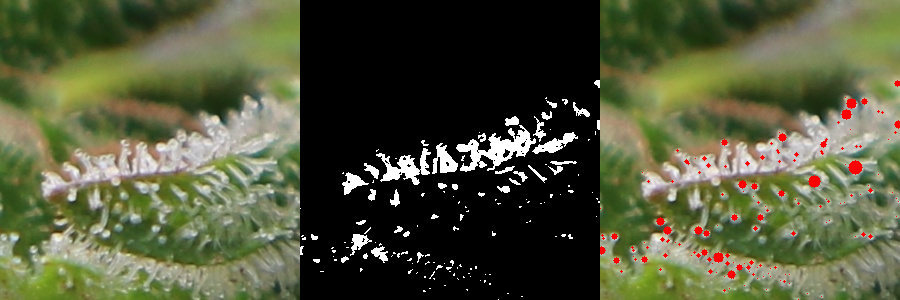

In [ ]:
for filename, total in ground_truth.items():
    detect_cirlces(filename, our_label=total)

### Rotation 90°

				Name: IMG_5757_p27, Total Trichomes: 191, We labeled 163


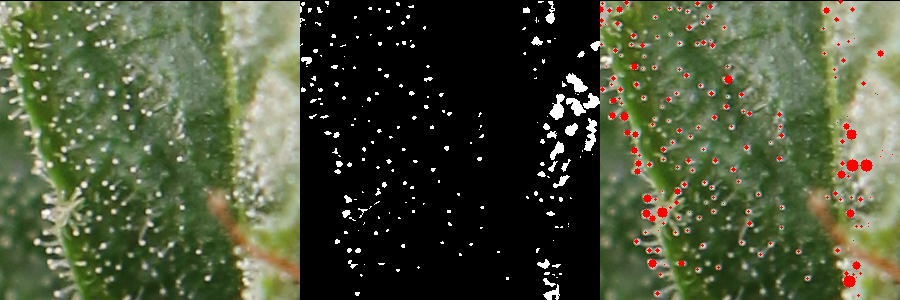

				Name: IMG_5883_p10, Total Trichomes: 142, We labeled 113


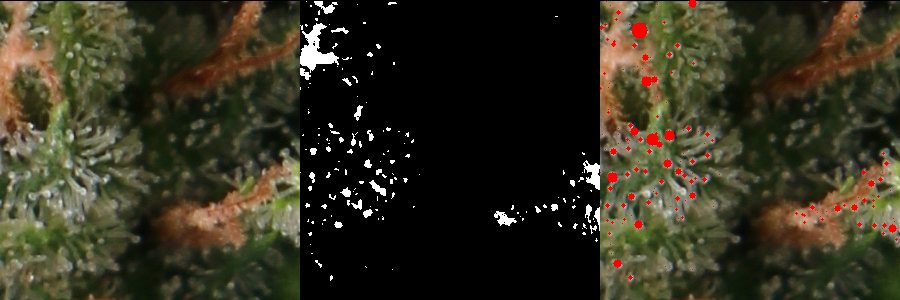

				Name: IMG_5883_p16, Total Trichomes: 164, We labeled 103


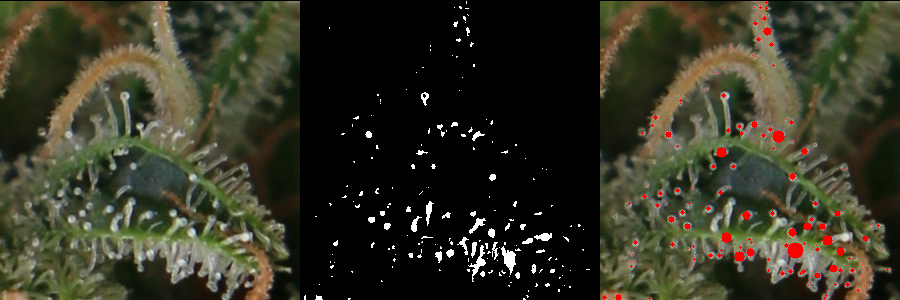

				Name: IMG_5883_p9, Total Trichomes: 218, We labeled 140


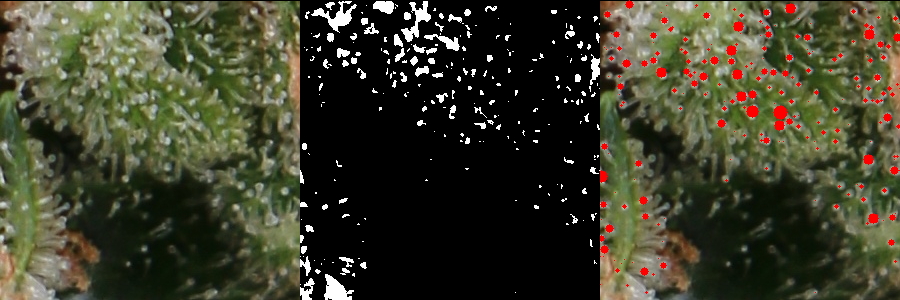

				Name: IMG_5884_p24, Total Trichomes: 86, We labeled 75


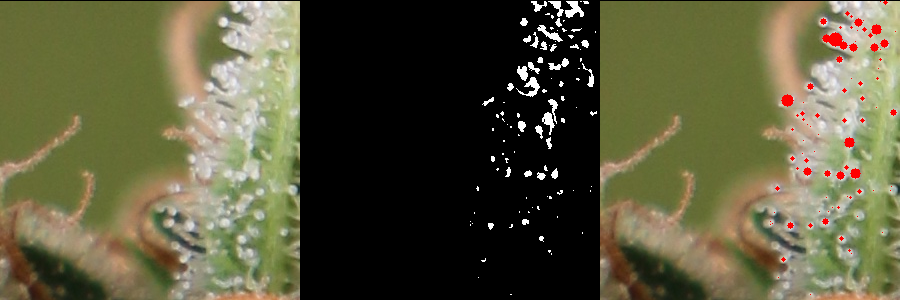

				Name: IMG_5884_p12, Total Trichomes: 6, We labeled 45


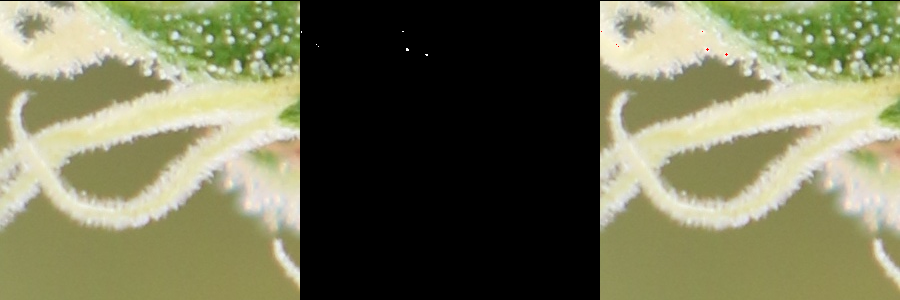

				Name: IMG_5884_p9, Total Trichomes: 212, We labeled 86


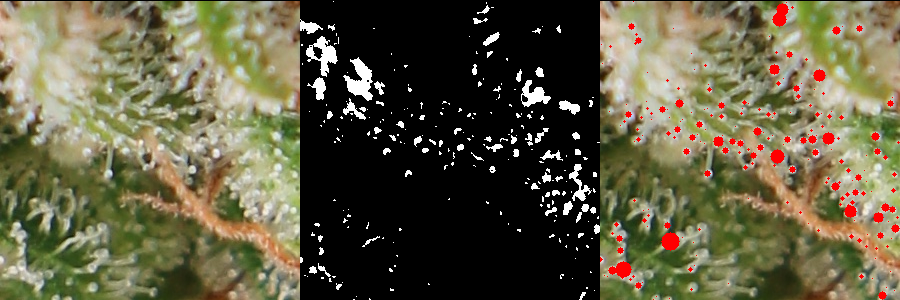

				Name: IMG_5885_p2, Total Trichomes: 58, We labeled 72


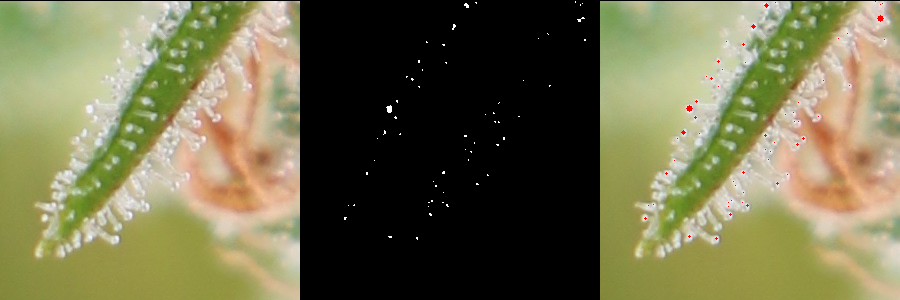

				Name: IMG_5885_p20, Total Trichomes: 198, We labeled 82


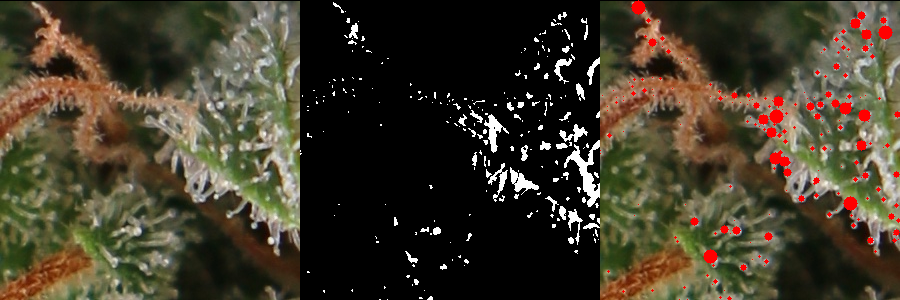

				Name: IMG_5885_p3, Total Trichomes: 143, We labeled 85


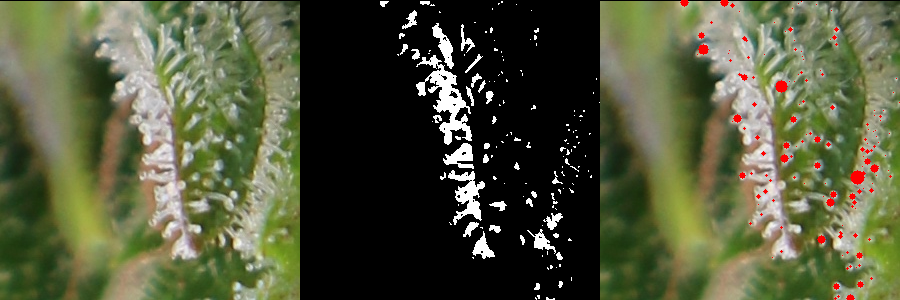

In [ ]:
for filename, total in ground_truth.items():
    detect_cirlces(filename, rotate=90, our_label=total)

### Rescale x 2

				Name: IMG_5757_p27, Total Trichomes: 139, We labeled 163


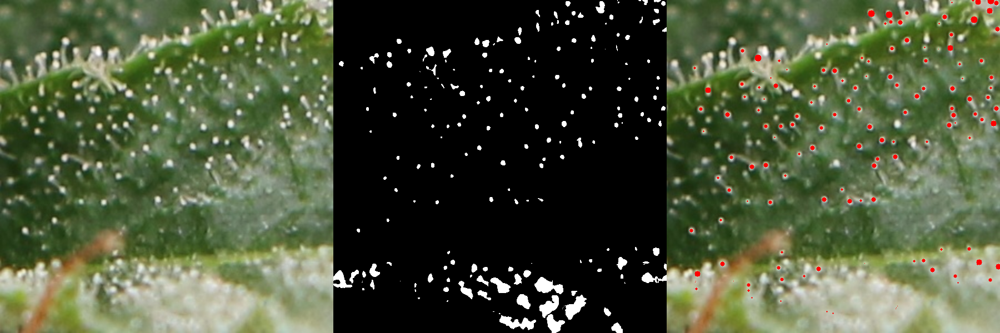

				Name: IMG_5883_p10, Total Trichomes: 88, We labeled 113


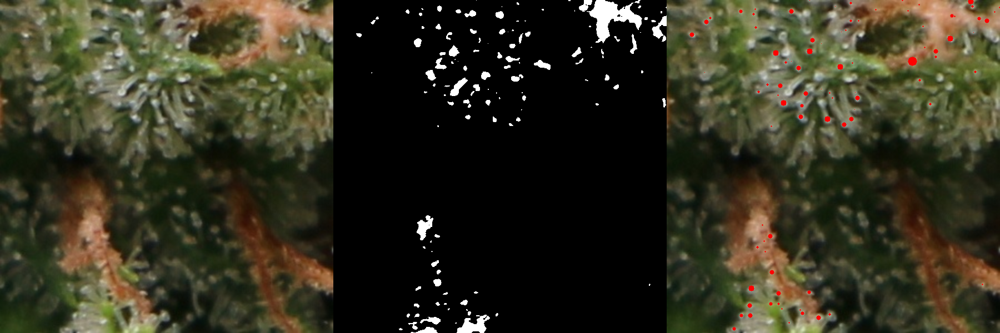

				Name: IMG_5883_p16, Total Trichomes: 103, We labeled 103


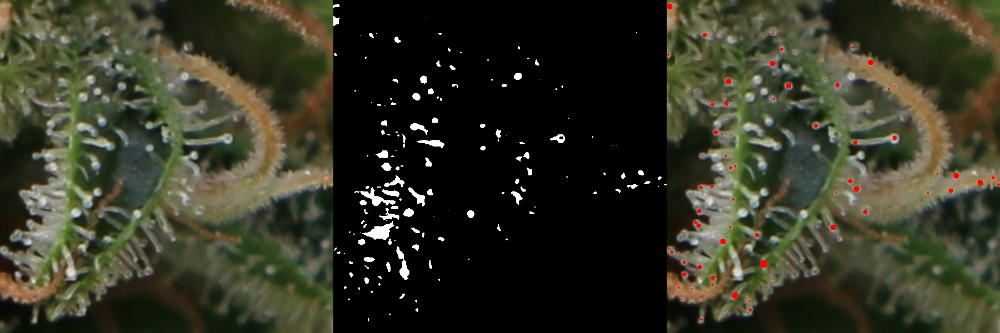

				Name: IMG_5883_p9, Total Trichomes: 120, We labeled 140


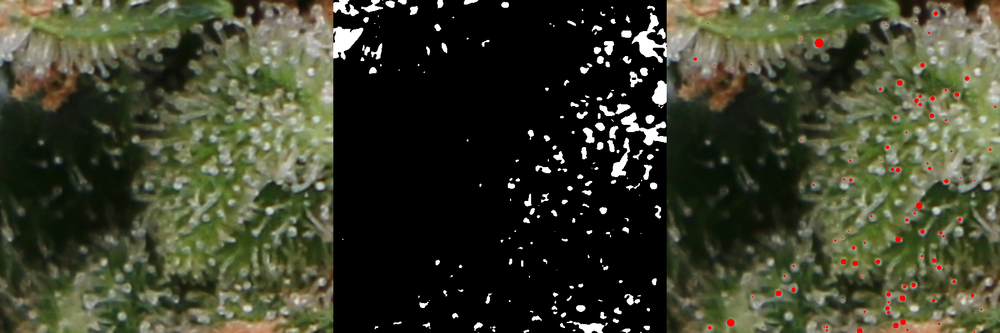

				Name: IMG_5884_p24, Total Trichomes: 49, We labeled 75


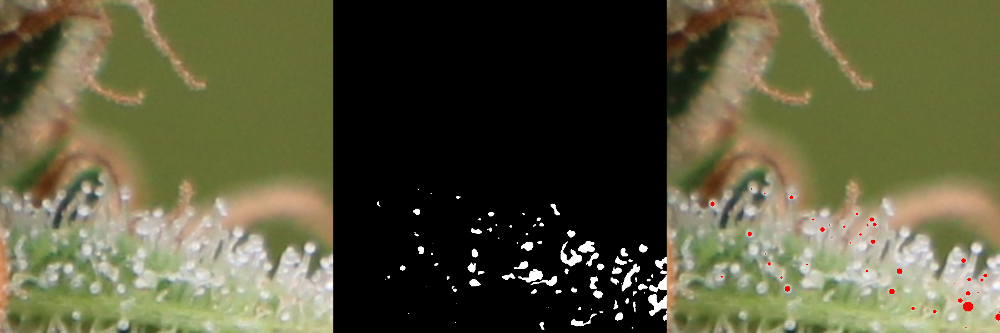

				Name: IMG_5884_p12, Total Trichomes: 4, We labeled 45


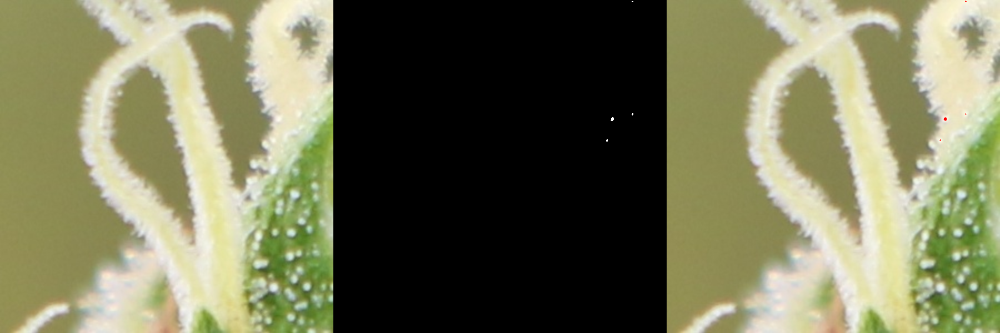

				Name: IMG_5884_p9, Total Trichomes: 138, We labeled 86


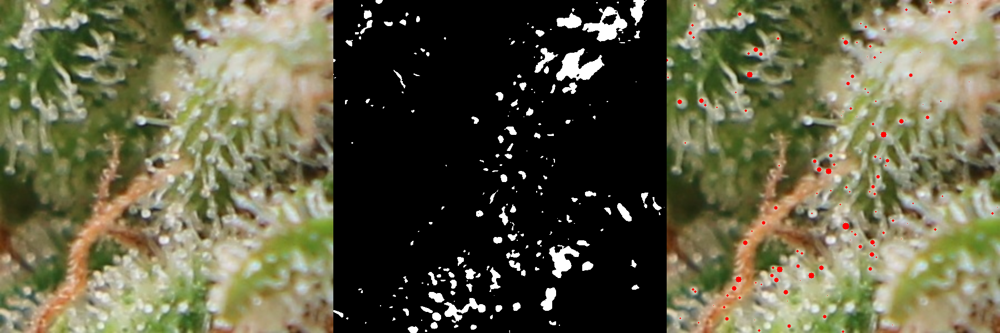

				Name: IMG_5885_p2, Total Trichomes: 48, We labeled 72


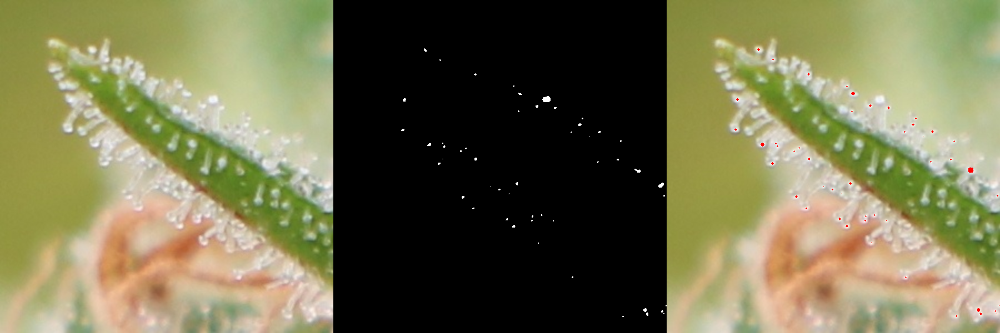

				Name: IMG_5885_p20, Total Trichomes: 137, We labeled 82


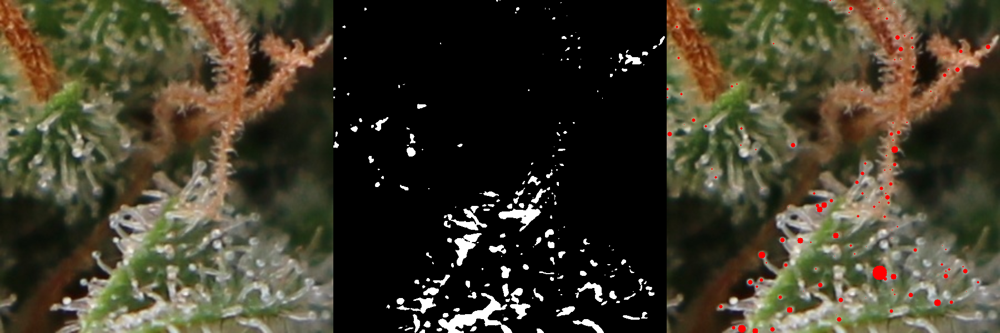

				Name: IMG_5885_p3, Total Trichomes: 93, We labeled 85


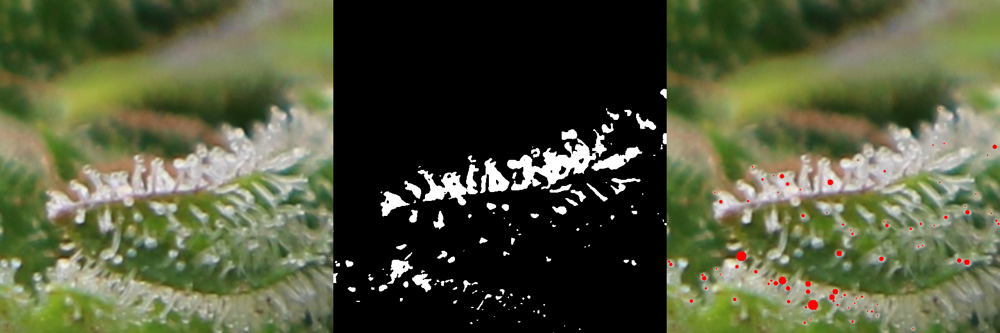

In [ ]:
for filename, total in ground_truth.items():
    detect_cirlces(filename, rescale=2, our_label=total)

### Rescale x 0.5

				Name: IMG_5757_p27, Total Trichomes: 165, We labeled 163


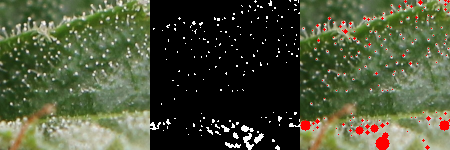

				Name: IMG_5883_p10, Total Trichomes: 93, We labeled 113


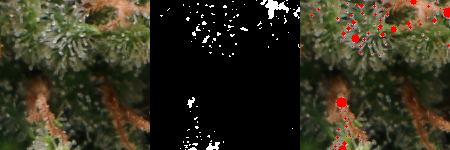

				Name: IMG_5883_p16, Total Trichomes: 102, We labeled 103


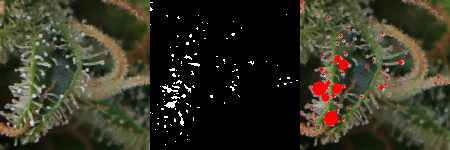

				Name: IMG_5883_p9, Total Trichomes: 160, We labeled 140


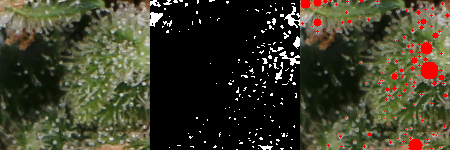

				Name: IMG_5884_p24, Total Trichomes: 72, We labeled 75


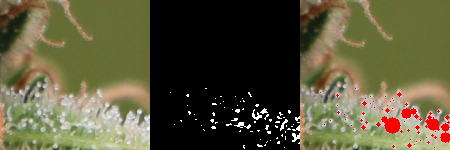

				Name: IMG_5884_p12, Total Trichomes: 4, We labeled 45


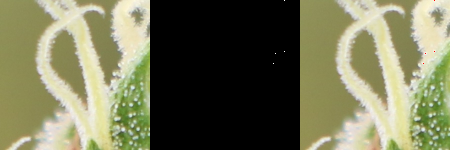

				Name: IMG_5884_p9, Total Trichomes: 137, We labeled 86


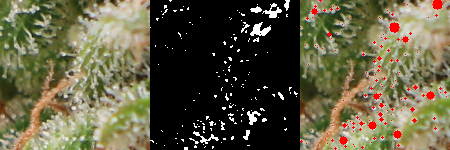

				Name: IMG_5885_p2, Total Trichomes: 26, We labeled 72


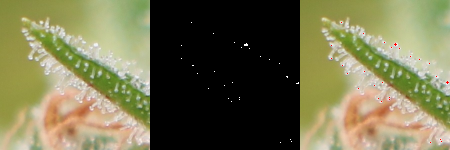

				Name: IMG_5885_p20, Total Trichomes: 134, We labeled 82


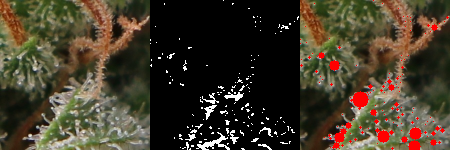

				Name: IMG_5885_p3, Total Trichomes: 84, We labeled 85


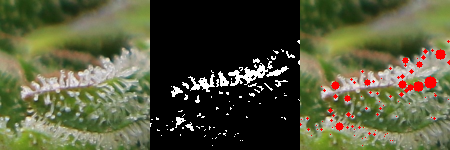

In [ ]:
for filename, total in ground_truth.items():
    detect_cirlces(filename, rescale=1/2, our_label=total)

### Flip Horizontal

				Name: IMG_5757_p27, Total Trichomes: 191, We labeled 163


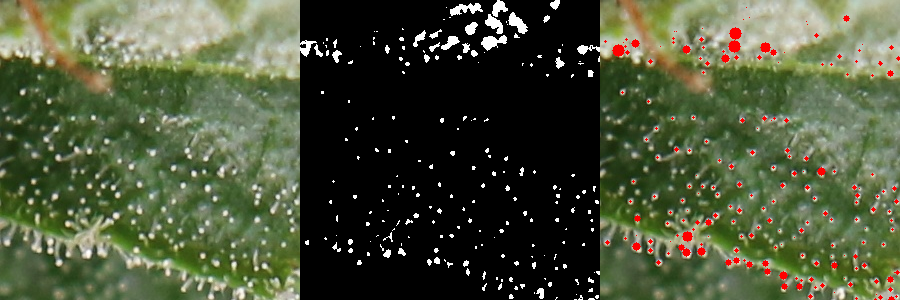

				Name: IMG_5883_p10, Total Trichomes: 142, We labeled 113


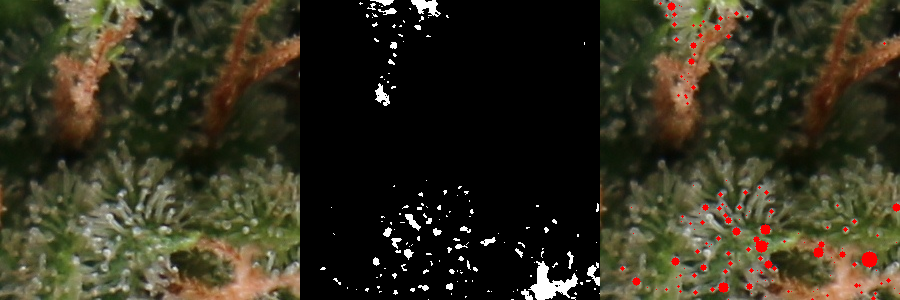

				Name: IMG_5883_p16, Total Trichomes: 164, We labeled 103


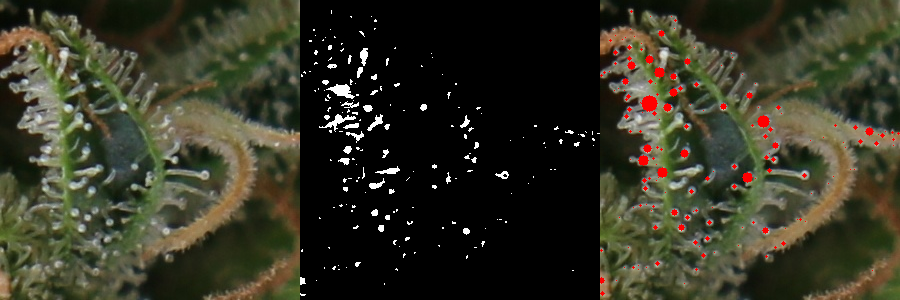

				Name: IMG_5883_p9, Total Trichomes: 218, We labeled 140


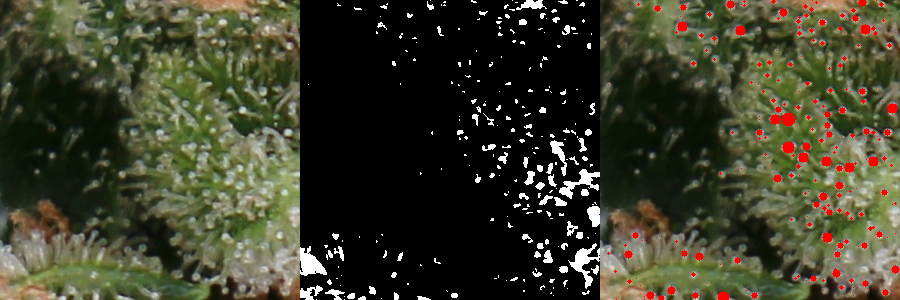

				Name: IMG_5884_p24, Total Trichomes: 81, We labeled 75


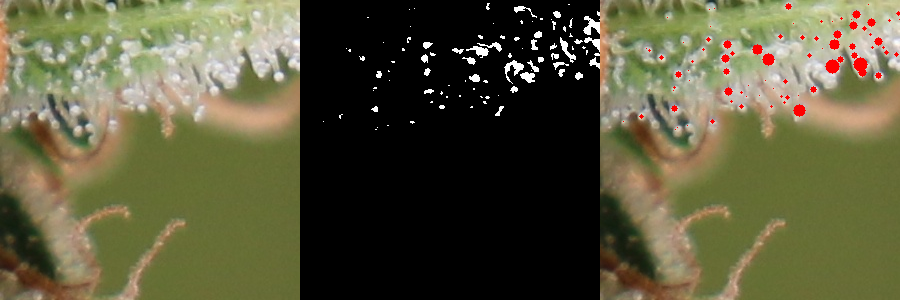

				Name: IMG_5884_p12, Total Trichomes: 6, We labeled 45


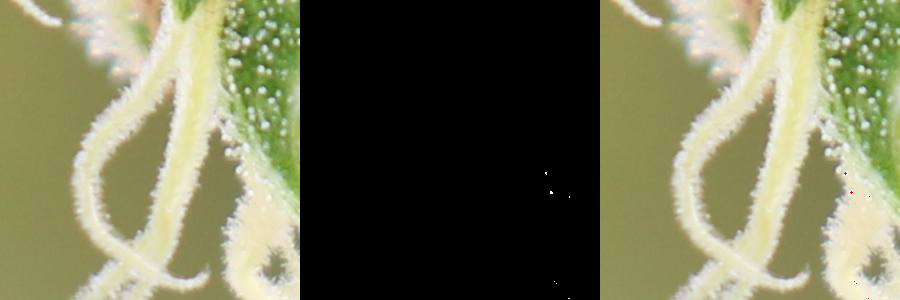

				Name: IMG_5884_p9, Total Trichomes: 213, We labeled 86


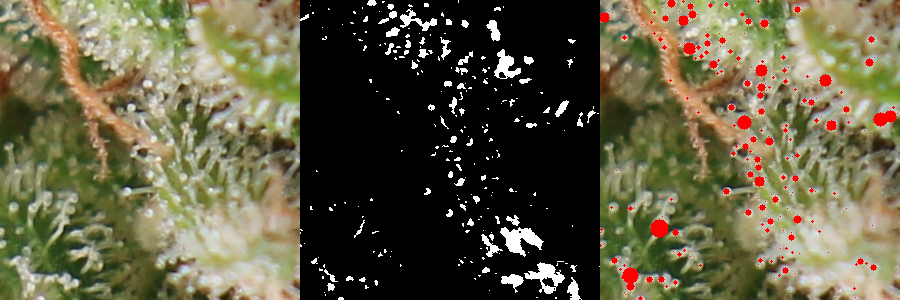

				Name: IMG_5885_p2, Total Trichomes: 55, We labeled 72


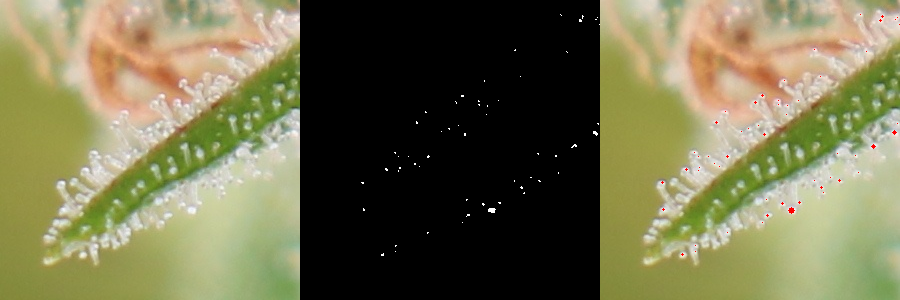

				Name: IMG_5885_p20, Total Trichomes: 198, We labeled 82


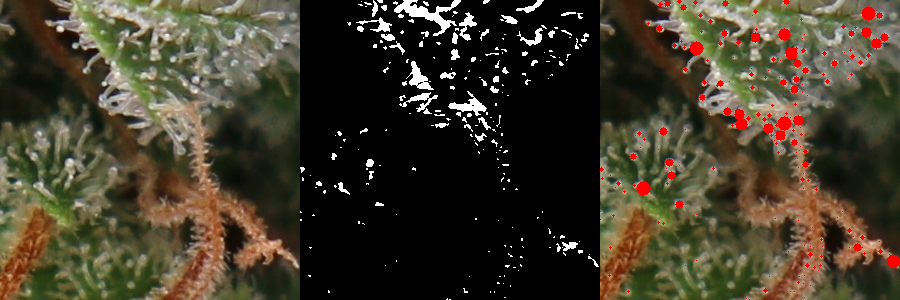

				Name: IMG_5885_p3, Total Trichomes: 146, We labeled 85


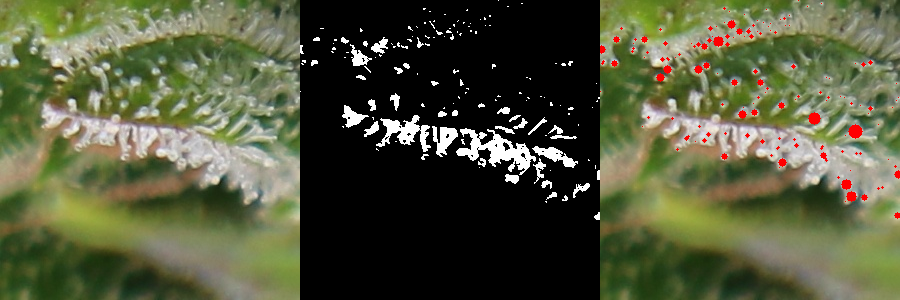

In [ ]:
for filename, total in ground_truth.items():
    detect_cirlces(filename, flip='horizontal', our_label=total)

### Flip Vertical

				Name: IMG_5757_p27, Total Trichomes: 191, We labeled 163


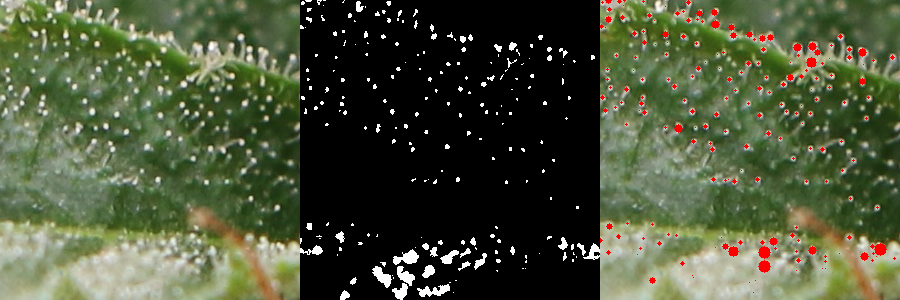

				Name: IMG_5883_p10, Total Trichomes: 142, We labeled 113


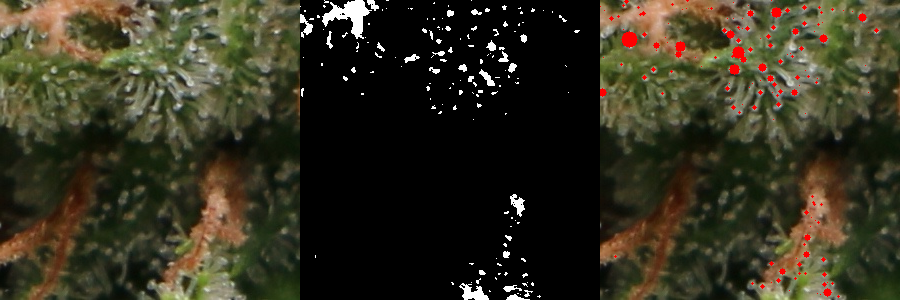

				Name: IMG_5883_p16, Total Trichomes: 164, We labeled 103


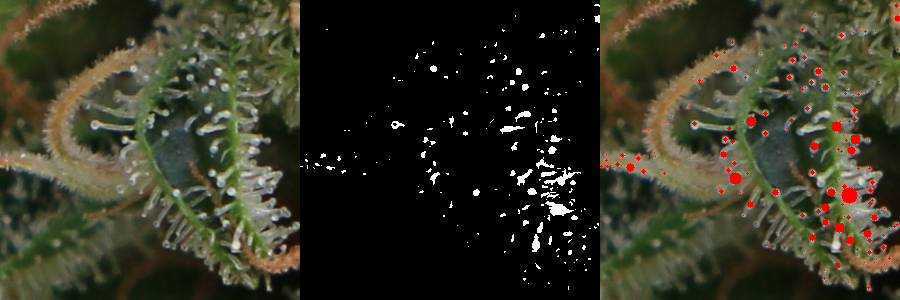

				Name: IMG_5883_p9, Total Trichomes: 218, We labeled 140


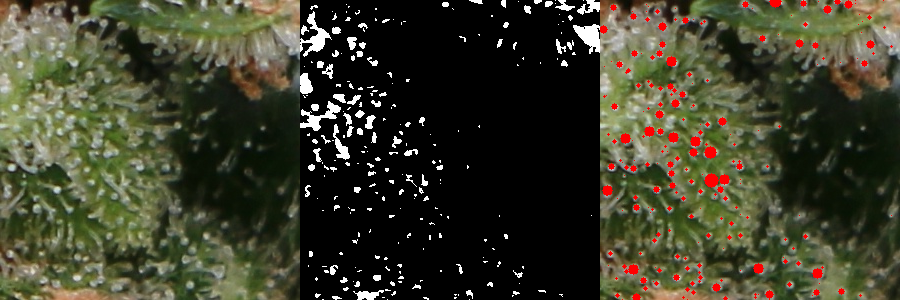

				Name: IMG_5884_p24, Total Trichomes: 81, We labeled 75


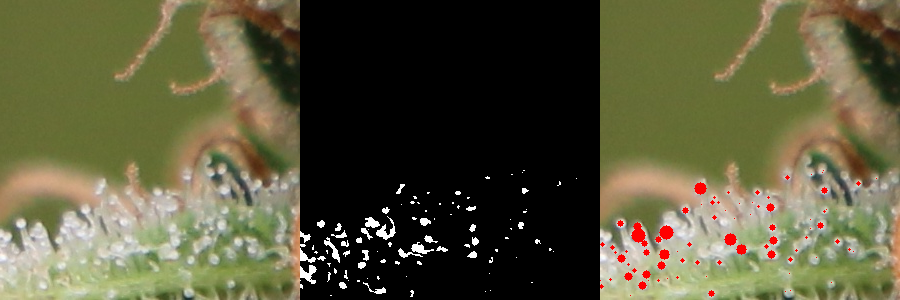

				Name: IMG_5884_p12, Total Trichomes: 6, We labeled 45


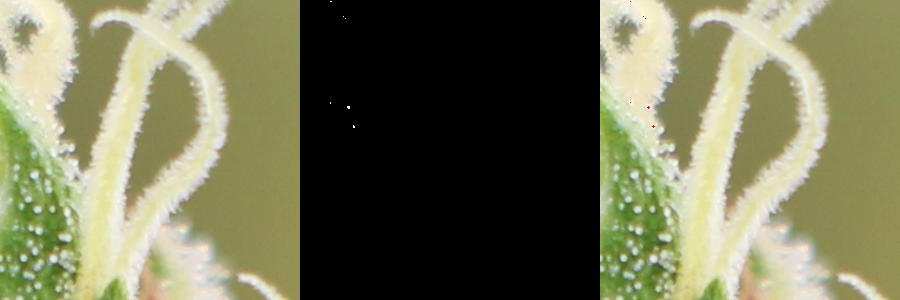

				Name: IMG_5884_p9, Total Trichomes: 213, We labeled 86


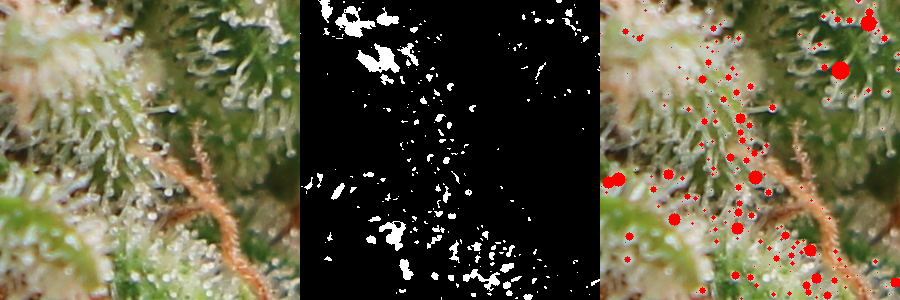

				Name: IMG_5885_p2, Total Trichomes: 55, We labeled 72


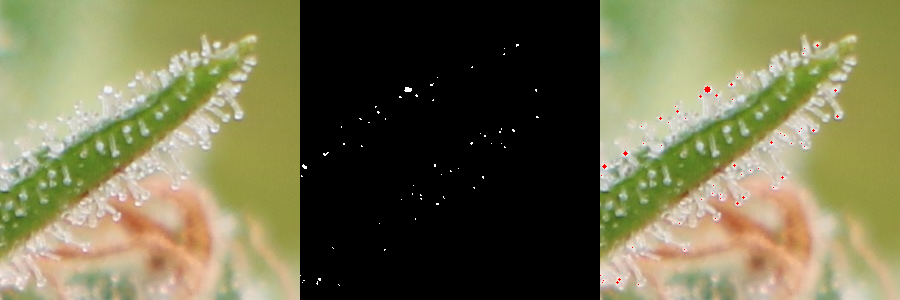

				Name: IMG_5885_p20, Total Trichomes: 198, We labeled 82


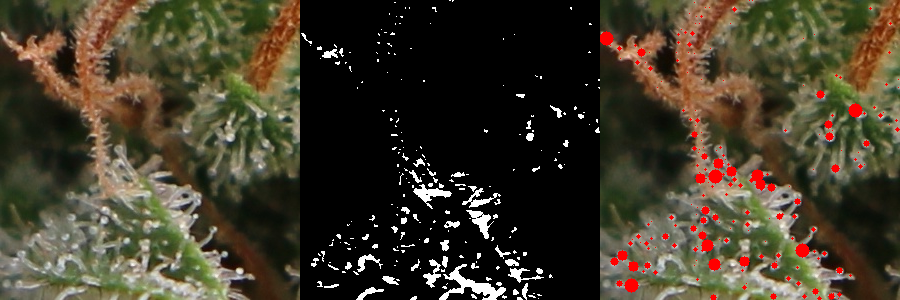

				Name: IMG_5885_p3, Total Trichomes: 146, We labeled 85


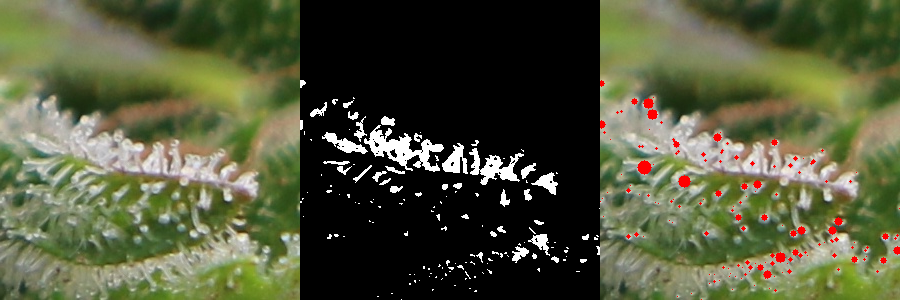

In [ ]:
for filename, total in ground_truth.items():
    detect_cirlces(filename, flip='vertical', our_label=total)

### Flip Both

				Name: IMG_5757_p27, Total Trichomes: 191, We labeled 163


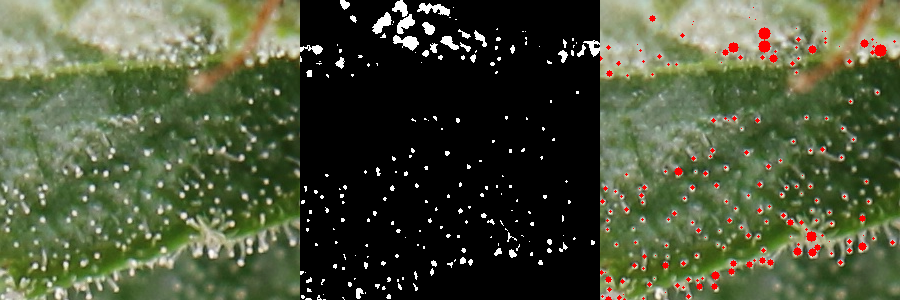

				Name: IMG_5883_p10, Total Trichomes: 142, We labeled 113


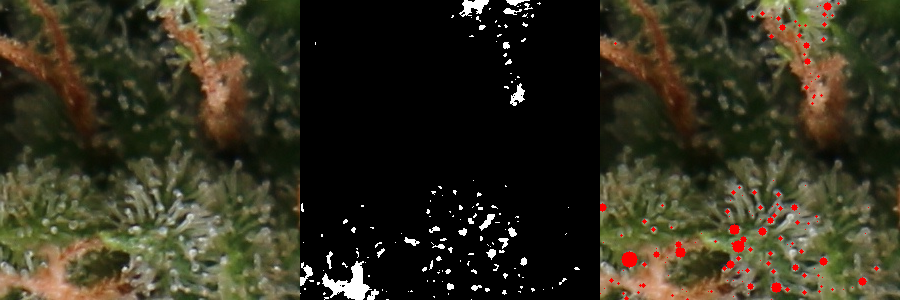

				Name: IMG_5883_p16, Total Trichomes: 164, We labeled 103


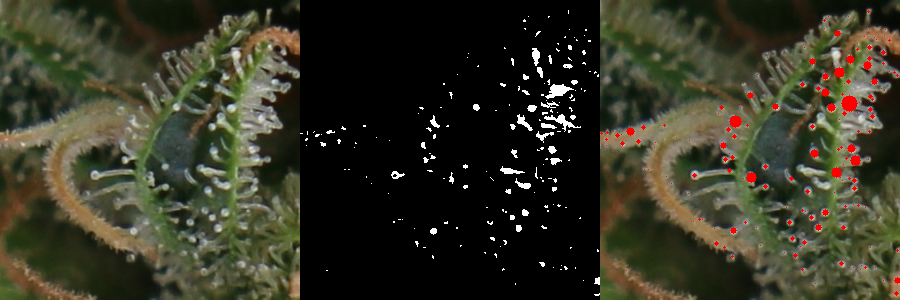

				Name: IMG_5883_p9, Total Trichomes: 218, We labeled 140


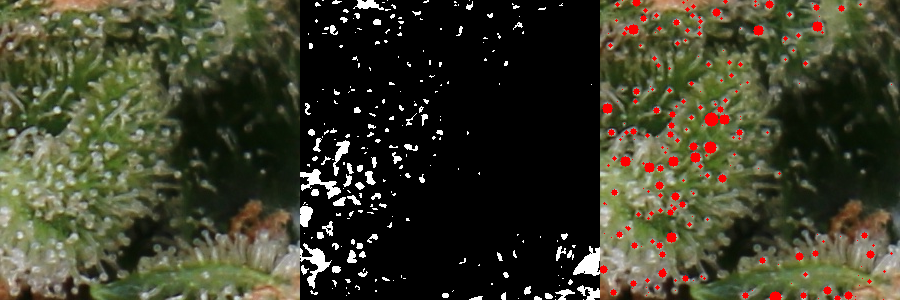

				Name: IMG_5884_p24, Total Trichomes: 81, We labeled 75


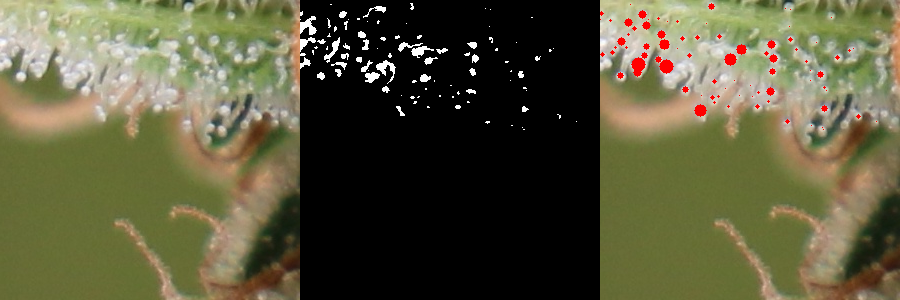

				Name: IMG_5884_p12, Total Trichomes: 6, We labeled 45


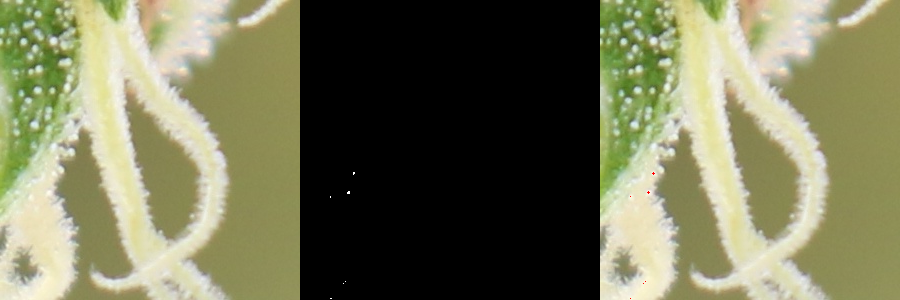

				Name: IMG_5884_p9, Total Trichomes: 213, We labeled 86


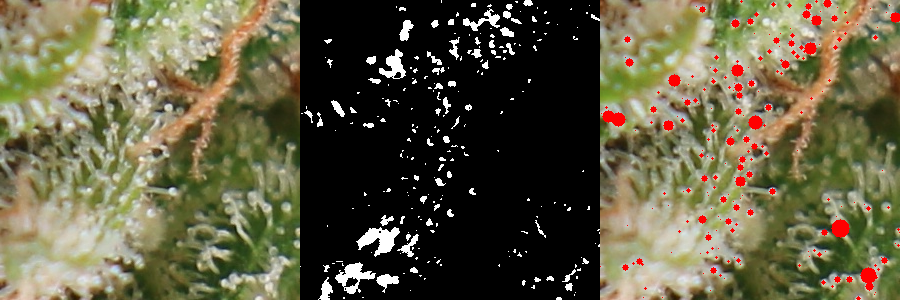

				Name: IMG_5885_p2, Total Trichomes: 55, We labeled 72


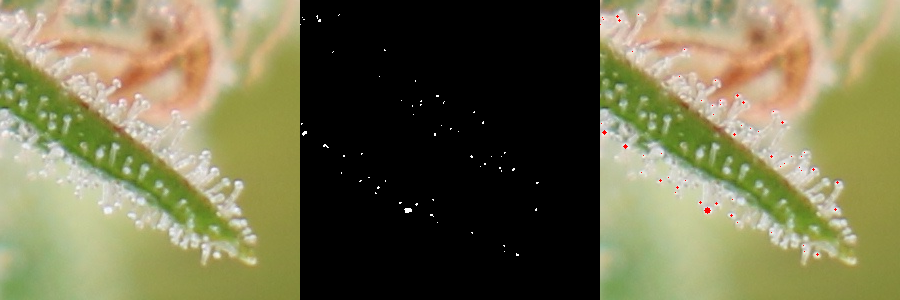

				Name: IMG_5885_p20, Total Trichomes: 198, We labeled 82


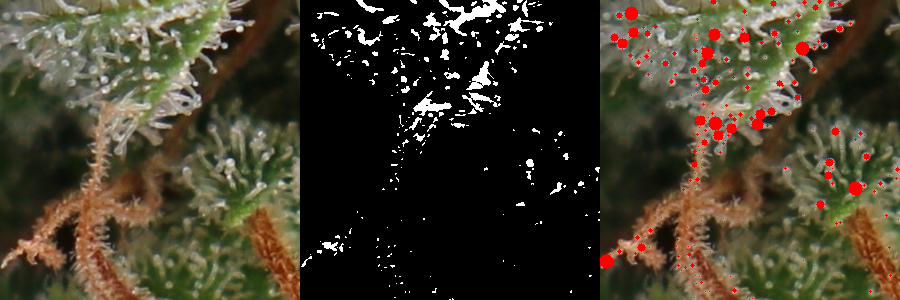

				Name: IMG_5885_p3, Total Trichomes: 146, We labeled 85


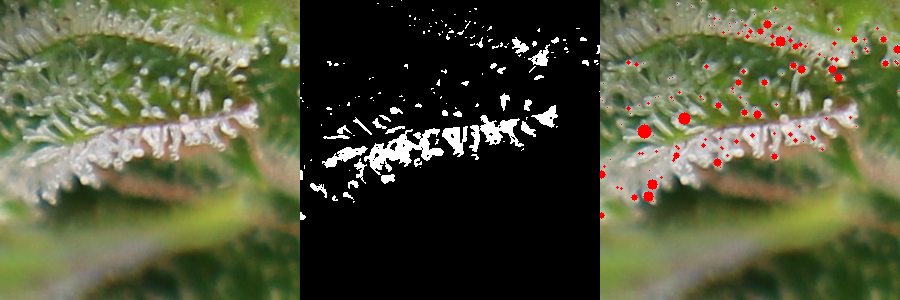

In [ ]:
for filename, total in ground_truth.items():
    detect_cirlces(filename, flip='both', our_label=total)

### Rotation `90°` + Rescale `X2` + Flip `both`

				Name: IMG_5757_p27, Total Trichomes: 139, We labeled 163


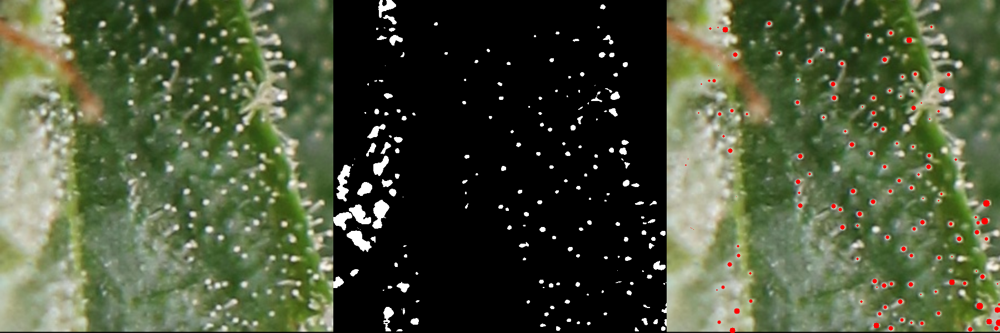

				Name: IMG_5883_p10, Total Trichomes: 91, We labeled 113


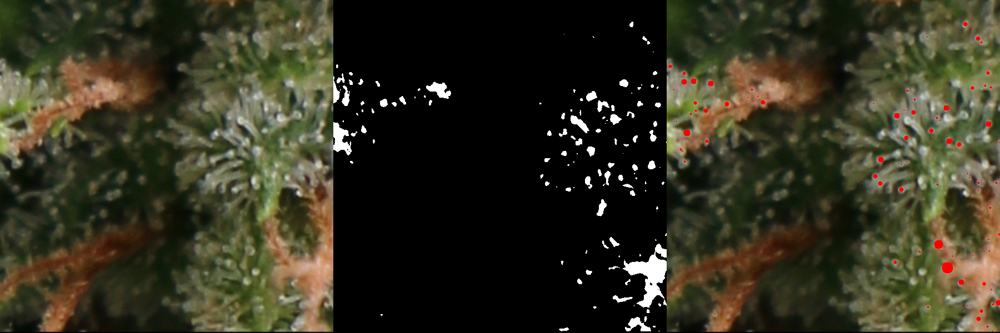

				Name: IMG_5883_p16, Total Trichomes: 103, We labeled 103


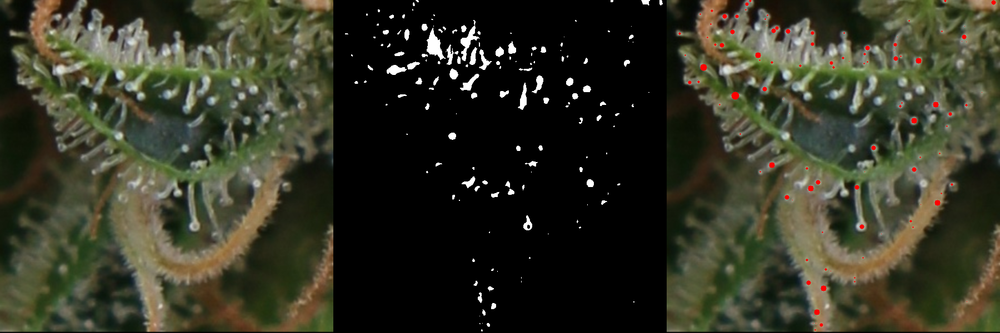

				Name: IMG_5883_p9, Total Trichomes: 123, We labeled 140


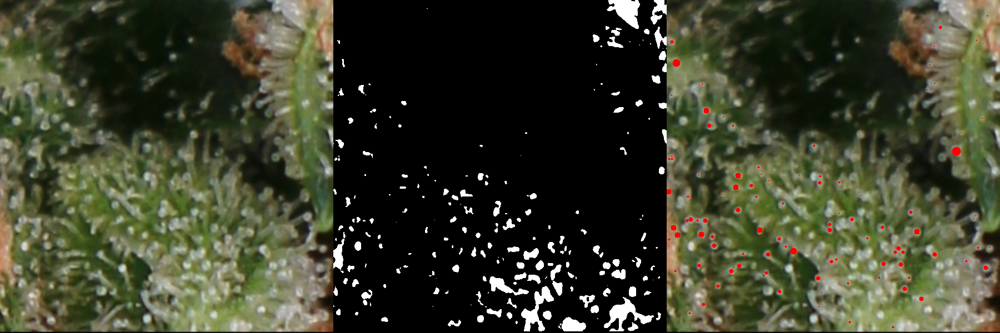

				Name: IMG_5884_p24, Total Trichomes: 48, We labeled 75


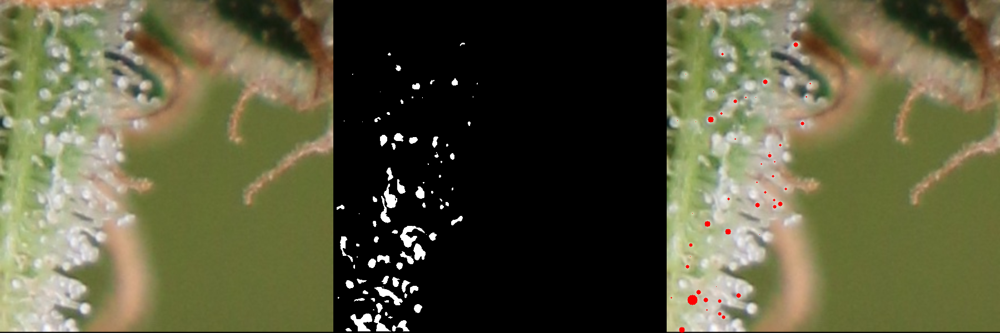

				Name: IMG_5884_p12, Total Trichomes: 4, We labeled 45


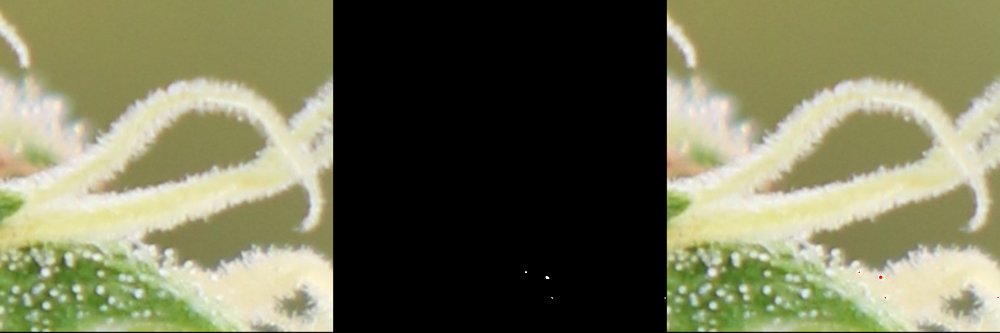

				Name: IMG_5884_p9, Total Trichomes: 140, We labeled 86


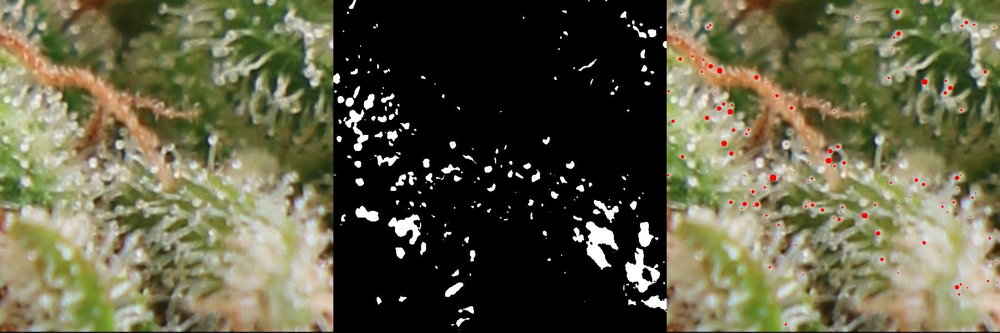

				Name: IMG_5885_p2, Total Trichomes: 48, We labeled 72


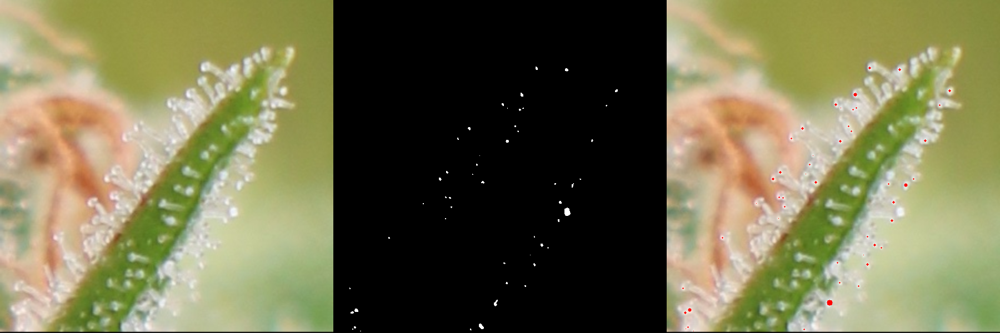

				Name: IMG_5885_p20, Total Trichomes: 140, We labeled 82


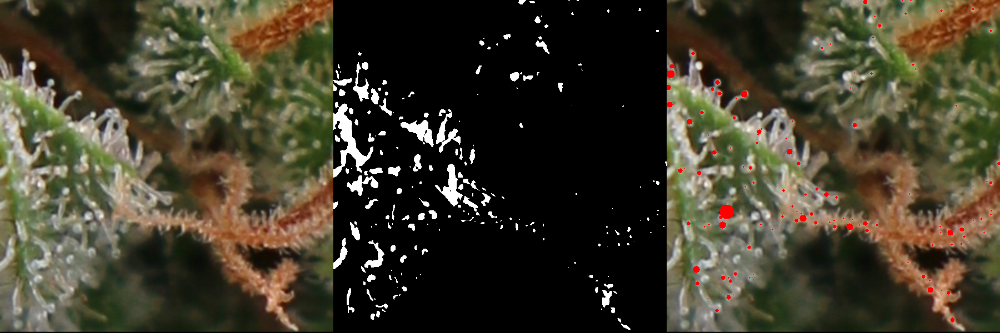

				Name: IMG_5885_p3, Total Trichomes: 95, We labeled 85


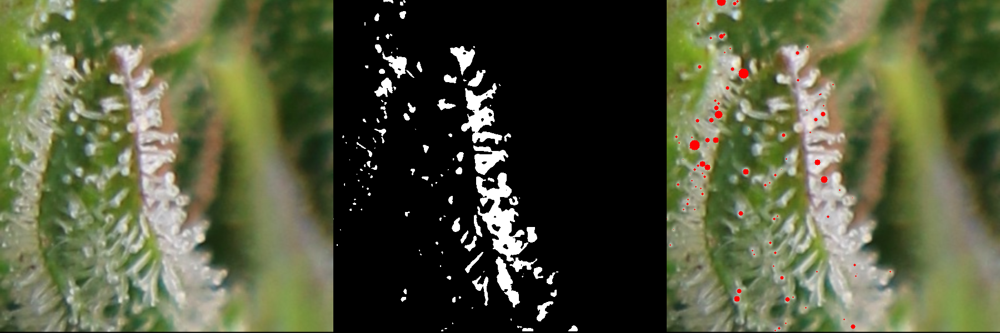

In [ ]:
for filename, total in ground_truth.items():
    detect_cirlces(filename, rotate=90, rescale=2, flip='both', our_label=total)

## Circle detection using Hough Transform

In [ ]:
def detect_circles(img, minRadius, maxRadius, param1=118, param2=8, save_path=None):
  cimg = cv2.cvtColor(img,cv2.COLOR_GRAY2BGR)
  circles = cv2.HoughCircles(img,cv2.HOUGH_GRADIENT,1,5,
                          param1=param1,param2=param2,minRadius=minRadius,maxRadius=maxRadius)

  circles = np.uint16(np.around(circles))
  for i in circles[0,:]:
    # draw the outer circle
    cv2.circle(cimg,(i[0],i[1]),i[2],(0,255,0),1)
    # draw the center of the circle
    cv2.circle(cimg,(i[0],i[1]),2,(0,0,255),1)

  cv2.imwrite(save_path, cimg)  # save the image to the specified path
  cv2_imshow(cimg)
  cv2.waitKey(0)
  cv2.destroyAllWindows()
  print(f"number of circles detected {circles.shape[1]}")